#Assessment I - Image Classification with Convolutional Neural Network

##Importing Essential Tools

In [1]:
!pip install numpy matplotlib seaborn scikit-learn pillow tensorflow


[notice] A new release of pip is available: 23.0.1 -> 25.1.1
[notice] To update, run: pip install --upgrade pip


In [2]:
import os
import random
from collections import Counter

import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image

from sklearn.metrics import classification_report, confusion_matrix

import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization, GlobalAveragePooling2D, Input
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.optimizers import SGD, Adam
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.preprocessing import image
from tensorflow.keras.regularizers import l2
from tensorflow.keras.models import load_model

import time

##Datast Directories

Training and Validation Data

In [4]:
train_dir = 'marvel/marvel/train'
valid_dir = 'marvel/marvel/valid'

##Part I - Implementing Convolutional Neural Network from Scratch

###Data Understanding, Analysis, Visualization and Cleaning

####Data Understanding and Analysis

> **What does the dataset represent ?**
- The dataset contains images of 8 Marvel Heroes from the Marvel Cinematic Universe. Each class represents a marvel character making the dataset a multiclass dataset with which we will perform multiclass image classification using Convolutional Neural Network.

#####How many total Images are there in the Dataset?

In [5]:
def total_images_through_classes(directory):
    class_totals = {}
    for class_name in os.listdir(directory):
        class_path = os.path.join(directory, class_name)
        if os.path.isdir(class_path):
            image_files = [f for f in os.listdir(class_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
            class_totals[class_name] = len(image_files)
    return class_totals

In [6]:
train_totals = total_images_through_classes(train_dir)
valid_totals = total_images_through_classes(valid_dir)

In [7]:
total_train_count = 0
total_valid_count = 0
print("Training Images:")
print("Classes:")
for classs, count in train_totals.items():
    total_train_count += count
    print(f"'{classs}': {count} images")
print()
print("Validation Images:")
print("Classes:")
for classs, count in valid_totals.items():
    total_valid_count += count
    print(f"'{classs}': {count} images")

print()
print(f"Total Training Images Count: {total_train_count}")
print(f"Total Validation Images Count: {total_valid_count}")
print(f"Total Images Count: {total_train_count + total_valid_count}")

Training Images:
Classes:
'loki': 307 images
'black widow': 320 images
'hulk': 321 images
'doctor strange': 345 images
'captain america': 324 images
'spider-man': 326 images
'thanos': 323 images
'ironman': 318 images

Validation Images:
Classes:
'loki': 54 images
'black widow': 55 images
'hulk': 56 images
'doctor strange': 61 images
'captain america': 57 images
'spider-man': 57 images
'thanos': 55 images
'ironman': 56 images

Total Training Images Count: 2584
Total Validation Images Count: 451
Total Images Count: 3035


**Explanation**
> From the above codes can could calculate the number of classes in the dataset.
>> There are total 8 Classes in the dataset

>> Training Images
>>> 'loki': 307 images

>>> 'hulk': 321 images

>>> 'thanos': 323 images  

>>> 'ironman': 318 images  

>>> 'doctor strange': 345 images  

>>> 'spider-man': 326 images  

>>> 'black widow': 320 images  

>>> 'captain america': 324 images  

>> Validation Images
>>> 'ironman': 56 images

>>> 'loki': 54 images  

>>> 'thanos': 55 images

>>> 'spider-man': 57 images  

>>> 'black widow': 55 images  

>>> 'doctor strange': 61 images  

>>> 'hulk': 56 images  

>>> 'captain america': 57 images  

>> Total Training Images: 2584

>> Total Testing Images: 451

>> ***Total Images: 3035 images***


#####How is the dataset split into training and validation sets?

In [8]:
print(f"Total Training Images Count: {total_train_count}")
print(f"Total Testing Images Count: {total_valid_count}")
print(f"Total Images Count: {total_train_count + total_valid_count}")

Total Training Images Count: 2584
Total Testing Images Count: 451
Total Images Count: 3035


> The dataset is pre-split into approximately 85% Training and approximately 15% for Validation. The training and validation dataset were both provided by the publisher of the dataset in Kaggle.

> We can also see that the data distribution of the classes are relatively balanced for both sets

####Data Visualization

#####What is the distribution of Data Across Different Classes

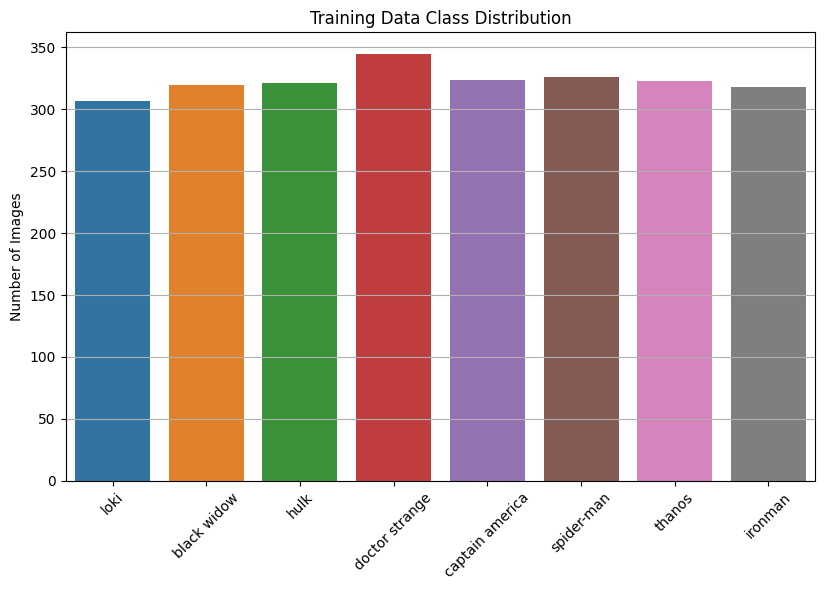

In [9]:
plt.figure(figsize=(16, 6))

plt.subplot(1, 2, 1)
sns.barplot(x=list(train_totals.keys()), y=list(train_totals.values()), hue=list(train_totals.keys()), legend=False)
plt.title('Training Data Class Distribution')
plt.ylabel('Number of Images')
plt.xticks(rotation=45)
plt.grid(axis='y')

plt.tight_layout()
plt.show()

> The distrubution of images in the training data are quite evenly distributed with 'doctor strange' class having the most number of images and the 'loki' class with the least number of images.

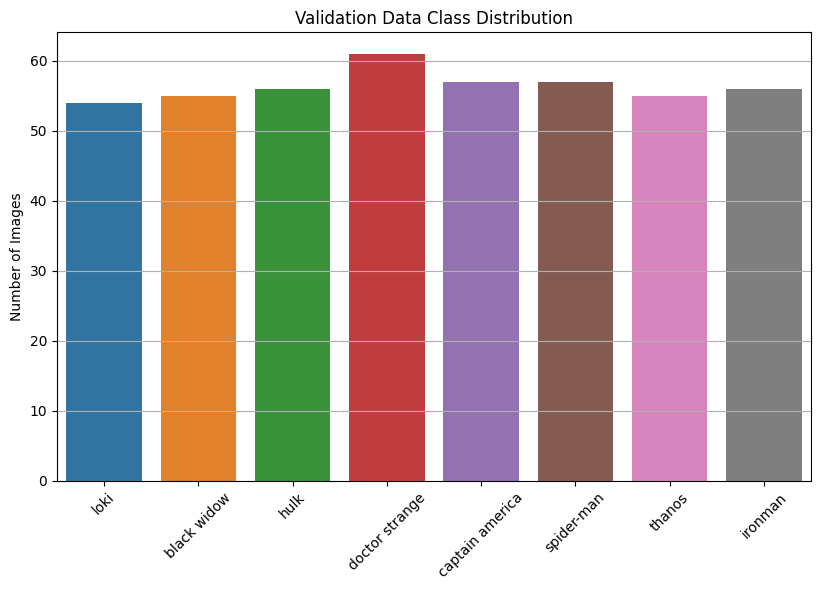

In [10]:
plt.figure(figsize=(16, 6))

plt.subplot(1, 2, 2)
sns.barplot(x=list(valid_totals.keys()), y=list(valid_totals.values()), hue=list(valid_totals.keys()), legend=False)
plt.title('Validation Data Class Distribution')
plt.ylabel('Number of Images')
plt.xticks(rotation=45)
plt.grid(axis='y')

plt.tight_layout()
plt.show()

> Similarly, distrubution of images in the validation data are also quite evenly distributed with 'doctor strange' class having the most number of images and the 'loki' class with the least number of images.

> Sample Images

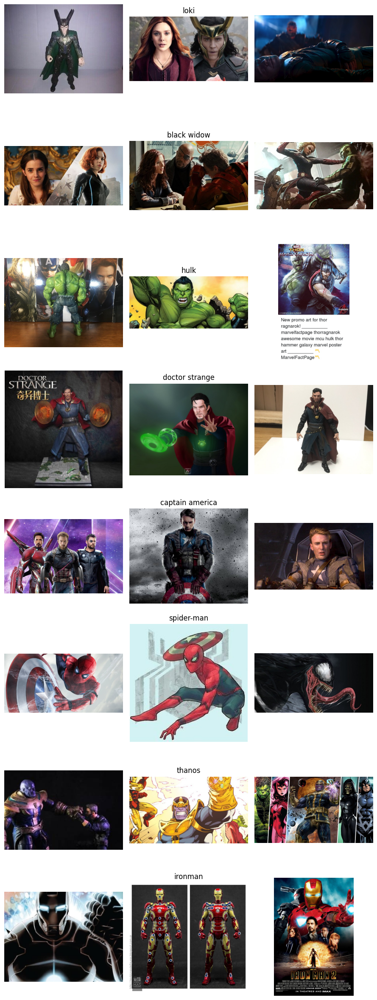

In [11]:
class_names = os.listdir(train_dir)
plt.figure(figsize=(3 * 3, len(class_names) * 3))
for i, cls in enumerate(class_names):
    cls_path = os.path.join(train_dir, cls)
    images = [img for img in os.listdir(cls_path) if img.endswith(('.jpg', '.jpeg', '.png'))]
    selected_images = random.sample(images, min(3, len(images)))
    for j, img_name in enumerate(selected_images):
        img_path = os.path.join(cls_path, img_name)
        image = Image.open(img_path).convert('RGB')
        plt.subplot(len(class_names), 3, i * 3 + j + 1)
        plt.imshow(image)
        plt.axis('off')
        if j == 1:
            plt.title(cls)
plt.tight_layout()
plt.show()

> We can see that the average width of the images in the dataset is 896.5px and the average height of the images in the dataset is 733.

> Since the averages of the width and height is around 897 and 733 respectively, downsampling the images to 244*244 will preserve most of the details in the image.

>We are downsampling the images to (244,244)px because it is a commonly used practice and many standard pre-trained models like VGG, MobileNet expect square inputs like (244,244)px

####Data Cleaning

In [12]:
def remove_corrupted_images(directory):
    removed = 0
    for subdir, _, files in os.walk(directory):
        for file in files:
            filepath = os.path.join(subdir, file)
            try:
                img = Image.open(filepath)
                img.verify()
            except (IOError, SyntaxError):
                print(f"Removing corrupt image: {filepath}")
                os.remove(filepath)
                removed += 1
    print(f"Total corrupt images removed: {removed}")

In [13]:
remove_corrupted_images(train_dir)
remove_corrupted_images(valid_dir)

Total corrupt images removed: 0
Total corrupt images removed: 0


> There were no corrupted images found in the dataset.

In [14]:
import os
from PIL import Image

def image_formats(folder_path):
    format_count = {}

    for subdir, _, files in os.walk(folder_path):
        for file in files:
            filepath = os.path.join(subdir, file)
            try:
                img = Image.open(filepath)
                img_format = img.format

                if img_format in format_count:
                    format_count[img_format] += 1
                else:
                    format_count[img_format] = 1
            except Exception as e:
                print(f"Error with image {filepath}: {e}")

    return format_count

formats_train = image_formats(train_dir)
formats_valid = image_formats(valid_dir)
print(formats_train)
print(formats_valid)


{'JPEG': 2584}
{'JPEG': 451}


> Here we can see that all the images in the dataset are of JPEG format.

>Changing the format of the images in the dataset into one consistent format is import because in .png file format, the image can be found in RGBA form whereas in JPEG format the images are only in RGB form.

>Because of the color channel differences, shape based errors can arise with inconsistent image file formats

>But since in our dataset all the images are in JPEG format there is not need to change it to any other file format.

###Data Augmentation, Resizing and Normalization

####Checking the Average Size of the Images in the Dataset for choosing the appropriate size for resizing

In [15]:
def collect_image_sizes(root_dir):
    widths, heights = [], []
    image_count = 0
    for folder, _, files in os.walk(root_dir):
        for fname in files:
            if fname.lower().endswith(('.jpg', '.jpeg', '.png')):
                path = os.path.join(folder, fname)
                try:
                    with Image.open(path) as img:
                        w, h = img.size
                        widths.append(w)
                        heights.append(h)
                    image_count += 1
                except Exception as e:
                    print(f"Error processing file {fname}: {e}")

    if image_count == 0:
        print("No images were processed.")
        return np.array([]), np.array([])

    return np.array(widths), np.array(heights)

w, h = collect_image_sizes(train_dir)

if w.size > 0 and h.size > 0:
    print(f"Widths:  min={w.min()}, max={w.max()}, mean={w.mean():.1f}")
    print(f"Heights: min={h.min()}, max={h.max()}, mean={h.mean():.1f}")
else:
    print("No valid image sizes were found.")


Widths:  min=80, max=7413, mean=896.5
Heights: min=80, max=15805, mean=733.5


####Resizing, Augmentation and Normalization

> Here we are applying the preprocessing techniques i.e.
- Resizing
- Normalization

> Then since the minimum image required per class is 500, and our dataset's each class contained only the average of 350 images per class we used
- Augmentation

> For increasing the number of images while training

In [16]:
targetSize = (224, 224) #Target Size for resizing
batch_size = 32
num_classes = 8
validation_split = 0.2 #20% for validation

In [17]:
train_datagen = ImageDataGenerator(
    rescale = 1./255, # we're normalizing here from 0 to 1 (range of rgb values 1 to 255)
    rotation_range = 10,
    width_shift_range = 0.05,
    height_shift_range = 0.05,
    zoom_range = 0.05,
    horizontal_flip = True,
    validation_split = 0.2 ##20% of the data will be used for validation
)

#data augmentation is performed only for the training dataset


In [18]:
training_dataset = train_datagen.flow_from_directory(
    train_dir,
    target_size = targetSize,
    batch_size = batch_size,
    class_mode = 'sparse',
    shuffle = True,
    seed = 123,
    subset = "training"
)

Found 2070 images belonging to 8 classes.


In [19]:
validation_dataset = train_datagen.flow_from_directory(
    train_dir,
    target_size = targetSize,
    batch_size = batch_size,
    class_mode = 'sparse',
    shuffle = False,
    seed = 123,
    subset = "validation"
)

Found 514 images belonging to 8 classes.


In [20]:
test_datagen = ImageDataGenerator(rescale=1./255)

test_dataset = test_datagen.flow_from_directory(
    valid_dir,
    target_size=targetSize,
    batch_size=32,
    class_mode='sparse',
    shuffle=False,
    seed=123
)

Found 451 images belonging to 8 classes.


####Visualization After Resizing, Augmentation and Normalization

In [21]:
training_dataset.class_indices.items()

dict_items([('black widow', 0), ('captain america', 1), ('doctor strange', 2), ('hulk', 3), ('ironman', 4), ('loki', 5), ('spider-man', 6), ('thanos', 7)])

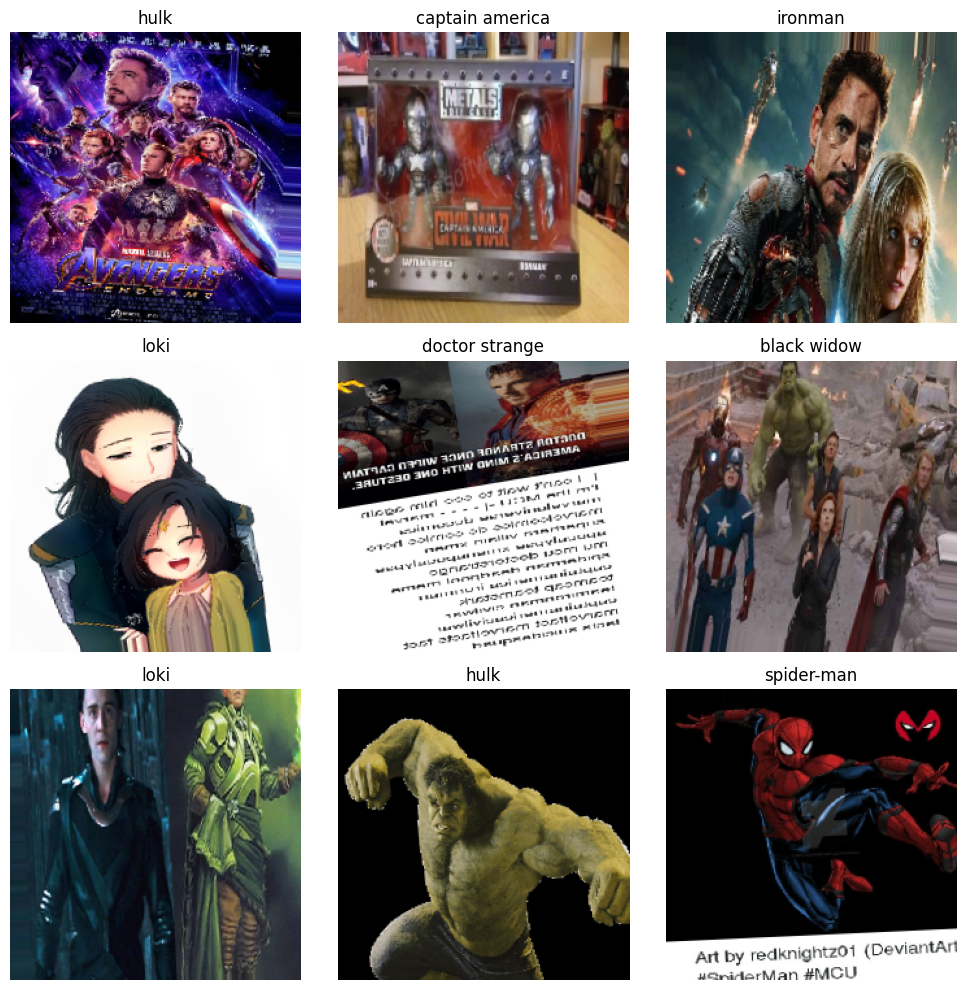

In [22]:
class_names = {}
for class_name, class_index in training_dataset.class_indices.items():
    class_names[class_index] = class_name
images, labels = next(training_dataset)

plt.figure(figsize=(10, 10))
for i in range(9):
    plt.subplot(3, 3, i+1)
    plt.imshow(images[i])
    plt.title(f"{class_names[int(labels[i])]}")
    plt.axis('off')
plt.tight_layout()
plt.show()

> After here we can see a batch of images with augmented images after using the ImageDataGenerator of Keras

###Design, Train and Evaluate a Baseline Model

####Model Architecture/Building

#####Basline SGD Model

In [23]:
input_shape = (224, 224, 3)
num_classes = 8

baseline_sgd_model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=input_shape),
    MaxPooling2D(2, 2),

    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D(2, 2),

    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D(2, 2),

    Flatten(),
    Dense(128, activation='relu'),
    Dense(64, activation='relu'),
    Dense(32, activation='relu'),
    Dense(num_classes, activation='softmax')
])

baseline_sgd_model.summary()

/Users/grumpyyy/.pyenv/versions/3.10.11/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 26, 26, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 86528)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │    11,075,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 8)              │           264 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,179,560 (42.65 MB)

 Trainable params: 11,179,560 (42.65 MB)

 Non-trainable params: 0 (0.00 B)

> This is the baseline model in which we will use the SGD optimizer. Here we can see the model's architecture.

> Here there are total of 11 layers where there are:
- Conv2D layer: 3
- MaxPooling Layer: 3
- Flatter Layer: 1
- Fully Connected Layers: 3
- Output Dense Layer with Softmax Activation Function: 1


#####Basline Adam Model

In [24]:
input_shape = (224, 224, 3)
num_classes = 8

baseline_adam_model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=input_shape),
    MaxPooling2D(2, 2),

    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D(2, 2),

    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D(2, 2),

    Flatten(),
    Dense(128, activation='relu'),
    Dense(64, activation='relu'),
    Dense(32, activation='relu'),
    Dense(num_classes, activation='softmax')
])

baseline_adam_model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_3 (Conv2D)               │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_5 (MaxPooling2D)  │ (None, 26, 26, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 86528)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 128)            │    11,075,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 8)              │           264 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,179,560 (42.65 MB)

 Trainable params: 11,179,560 (42.65 MB)

 Non-trainable params: 0 (0.00 B)

> This is the baseline model in which we will use the Adam optimizer.

> Here there are total of 11 layers where there are:
- Conv2D layer: 3
- MaxPooling Layer: 3
- Flatter Layer: 1
- Fully Connected Layers: 3
- Output Dense Layer with Softmax Activation Function: 1

#####Architecture Explanation

There are 11 layers in the baseline model.
- Conv2D layer: It applie filters to the input image which extracts features like corners, textures and edge informations as the layers increases the layer extracts more complex features like patterns and textures. (low-level, more complex, high-level features)
- MaxPooling2D layer: It takes the max value in each 2*2 block. It is used for downsampling which reduces the spatial size resulting in less load in computation. It makes the model more tolerable to small shifts or makes it less sensitive.
- Flatten layer: It is used to flattern the 3 dimensional feature map into a single 1 dimensional vector because the dense layer expects 1D vectors instead of 2D or 3D tensors.
- Dense Layer: It is the fully connected layers with certain number of assigned neurons. It combines the features learned by the CNN to make decisions. For instance: if convolotional layers extract features("edges", "colors"), the dense layer puts it together to provide an output("loki").

####Model Training

#####SGD Optimizer

In [25]:
baseline_sgd_model.compile(optimizer='sgd', #Stochastic Gradient Descent
              loss='sparse_categorical_crossentropy', #as the labels are integer-encoded (0, 1, 2, 3 , ..., 8)
              metrics=['accuracy']) #accuracy will be displayed at the time of training

In [26]:
callbacks = [
    ModelCheckpoint("baseline_sgd_model.keras", save_best_only=True, monitor="val_accuracy", mode="max"), #for saving the trained model it checks validation accuracy, mode max means higher results better
    EarlyStopping(monitor="val_loss", patience=10, restore_best_weights=True), #it is used to stop the training if the validation loss doesn't improve/decrease for 10 (patience) epochs also restores the weights to the best performing weights instead of last weights
]

history_baseline_sgd = baseline_sgd_model.fit(
    training_dataset,
    validation_data=validation_dataset,
    epochs=50,
    batch_size=batch_size,
    callbacks=callbacks
)

/Users/grumpyyy/.pyenv/versions/3.10.11/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 92s 1s/step - accuracy: 0.1424 - loss: 2.0807 - val_accuracy: 0.1381 - val_loss: 2.0808
Epoch 2/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 141s 2s/step - accuracy: 0.1245 - loss: 2.0783 - val_accuracy: 0.1537 - val_loss: 2.0764
Epoch 3/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 101s 2s/step - accuracy: 0.1514 - loss: 2.0749 - val_accuracy: 0.1323 - val_loss: 2.0767
Epoch 4/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 98s 2s/step - accuracy: 0.1333 - loss: 2.0764 - val_accuracy: 0.1362 - val_loss: 2.0731
Epoch 5/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 94s 1s/step - accuracy: 0.1561 - loss: 2.0724 - val_accuracy: 0.1323 - val_loss: 2.0761
Epoch 6/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 96s 1s/step - accuracy: 0.1508 - loss: 2.0692 - val_accuracy: 0.1518 - val_loss: 2.0694
Epoch 7/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 99s 2s/step - accuracy: 0.1467 - loss: 2.0677 - val_accuracy: 0.1284 - val_loss: 2.0727
Epoch 8/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 97s 1s/step - accuracy: 0.1609 - loss: 2.0681 - val_accuracy: 0.1537 - val_los

> During the training of the baseline model using the SGD optimizer, we observe consistent improvements in both training and validation accuracy from epoch 1 through epoch 34. The training accuracy increases from around 12% to 50.2%, while the validation accuracy rises from ~13% to a peak of 48.2%.

> The training loss steadily decreases across epochs, indicating that the model is learning the training data effectively. The validation loss also decreases until around epoch 35, after which it begins to fluctuate, suggesting potential convergence or the early onset of overfitting.


> By the final epochs, the model achieves its best validation loss of 1.4242 (epoch 49) and maintains validation accuracy around 46–48%. This suggests that the model may have reached its learning limit under the current setup (architecture, optimizer, and learning rate), and further improvement may require hyperparameter tuning or model architecture adjustments.

#####Adam Optimizer

In [27]:
baseline_adam_model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

In [28]:
callbacks = [
    ModelCheckpoint("baseline_adam_model.keras", save_best_only=True, monitor="val_accuracy", mode="max"),
    EarlyStopping(monitor="val_loss", patience=10, restore_best_weights=True),
]

history_baseline_adam = baseline_adam_model.fit(
    training_dataset,
    validation_data=validation_dataset,
    epochs=30,
    batch_size=batch_size,
    callbacks=callbacks
)

Epoch 1/30
65/65 ━━━━━━━━━━━━━━━━━━━━ 42s 626ms/step - accuracy: 0.1425 - loss: 2.1158 - val_accuracy: 0.1693 - val_loss: 2.0541
Epoch 2/30
65/65 ━━━━━━━━━━━━━━━━━━━━ 40s 610ms/step - accuracy: 0.1781 - loss: 2.0467 - val_accuracy: 0.1673 - val_loss: 1.9468
Epoch 3/30
65/65 ━━━━━━━━━━━━━━━━━━━━ 49s 753ms/step - accuracy: 0.2131 - loss: 2.0054 - val_accuracy: 0.2821 - val_loss: 1.9300
Epoch 4/30
65/65 ━━━━━━━━━━━━━━━━━━━━ 72s 1s/step - accuracy: 0.2018 - loss: 1.9664 - val_accuracy: 0.2840 - val_loss: 1.8587
Epoch 5/30
65/65 ━━━━━━━━━━━━━━━━━━━━ 58s 898ms/step - accuracy: 0.2298 - loss: 1.9477 - val_accuracy: 0.3074 - val_loss: 1.8170
Epoch 6/30
65/65 ━━━━━━━━━━━━━━━━━━━━ 58s 893ms/step - accuracy: 0.2405 - loss: 1.9000 - val_accuracy: 0.2899 - val_loss: 1.8251
Epoch 7/30
65/65 ━━━━━━━━━━━━━━━━━━━━ 65s 1s/step - accuracy: 0.2746 - loss: 1.8930 - val_accuracy: 0.2938 - val_loss: 1.8061
Epoch 8/30
65/65 ━━━━━━━━━━━━━━━━━━━━ 61s 933ms/step - accuracy: 0.2776 - loss: 1.8740 - val_accuracy: 

> While training the baseline model with the Adam optimizer, we were able to obtain a maximum training accuracy of approximately 76.9% and a validation accuracy of approximately 53.5% by epoch 29. Although EarlyStopping was not triggered, potential overfitting begins to emerge beyond epoch 24.

> We can observe that the model trains well with steady increases in both training and validation accuracy up to epoch 24. After this point, although the training accuracy continues to rise, the validation accuracy begins to fluctuate and the validation loss starts increasing, indicating that the model is overfitting to the training data.


> This overfitting may stem from the absence of dropout layers, regularization, or batch normalization. Additionally, due to the small dataset size, the model may begin to memorize specific patterns rather than learning generalizable features.

> Moreover, since the Adam optimizer converges faster than SGD, it may lead to overfitting if regularization techniques or learning rate strategies are not properly employed.


> The issue of overfitting is better addressed in the deeper architecture, which likely includes those corrective design choices.

####Model Evaluation

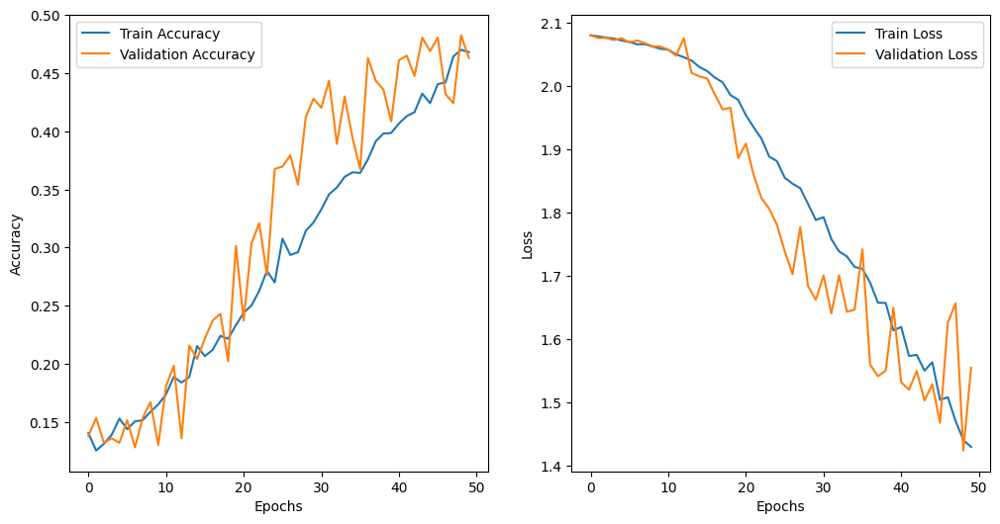

In [29]:
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(history_baseline_sgd.history['accuracy'], label='Train Accuracy')
plt.plot(history_baseline_sgd.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history_baseline_sgd.history['loss'], label='Train Loss')
plt.plot(history_baseline_sgd.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.show()

> Here in the plotted figure of training accuracy, validation accuracy and training loss, validation loss for the baseline model using sgd optimizer we can see
- Both training and validation accuracy are increasing consistently without unnatural behaviour
- Also, training and validation loss are also decreasing in a consistent manner until the final epochs.
- Only at the final epochs the model reaches convergence and the validation loss doesn't decrease from that point and the model slightly starts to overfit as the validation accuracy and validation loss are halted but the training accuracy is moving up.
- But with the help of the early stopping, the model quickly stops training after noticing such overfitting patterns

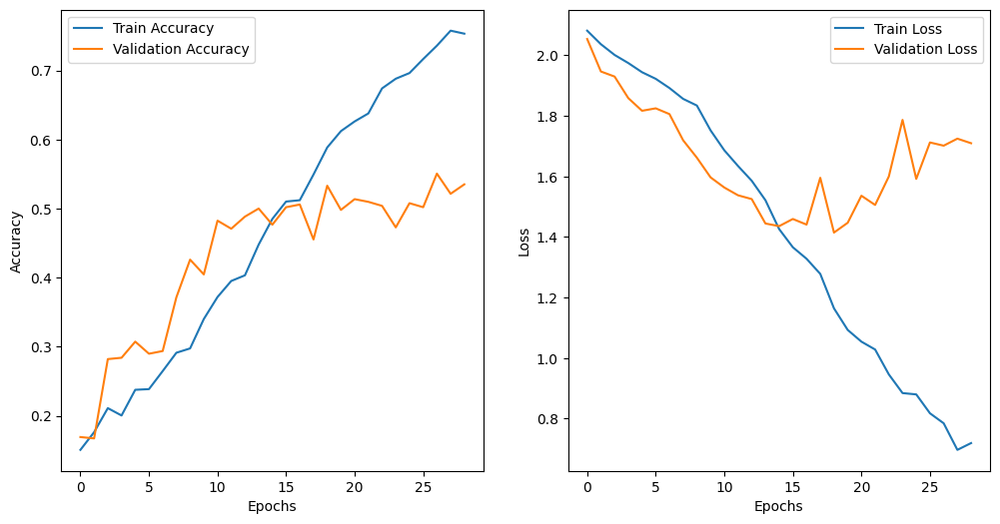

In [30]:
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(history_baseline_adam.history['accuracy'], label='Train Accuracy')
plt.plot(history_baseline_adam.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history_baseline_adam.history['loss'], label='Train Loss')
plt.plot(history_baseline_adam.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.show()

> Here in the plotted figure of training accuracy, validation accuracy and training loss, validation loss for the baseline model using sgd optimizer we can see
- At first the accuracy and validation accuracy are incrsing in a similar rate but after around epoch 15, the training accuracy is rapidly increasing but the validation accuracy remains the same with the rate of increase becoming slower.
- Moreover, we can see clear signs of overfitting when we look at the loss figure, the training and validation loss are decreasing till epoch 15, but after that the validation loss starts rapidly increasing which shows that the model is not able to generalize and overfitting heavily with validation accuracy taking a dip and validation loss increasing with training accuracy increasing

In [31]:
test_loss, test_accuracy = baseline_sgd_model.evaluate(test_dataset)

print(f"Test Loss: {test_loss:.4f}")
print(f"Test Accuracy: {test_accuracy:.4f}")

15/15 ━━━━━━━━━━━━━━━━━━━━ 3s 191ms/step - accuracy: 0.2912 - loss: 2.0041
Test Loss: 1.8004
Test Accuracy: 0.3570


> Here the baseline model using sgd optimizer is able to attain the accuracy of only 37%

In [32]:
y_true = test_dataset.classes
y_pred_probs = baseline_sgd_model.predict(test_dataset)
y_pred = np.argmax(y_pred_probs, axis=1)

class_names = list(test_dataset.class_indices.keys())

print(classification_report(y_true, y_pred, target_names=class_names))

15/15 ━━━━━━━━━━━━━━━━━━━━ 5s 326ms/step
                 precision    recall  f1-score   support

    black widow       0.38      0.15      0.21        55
captain america       0.30      0.30      0.30        57
 doctor strange       0.34      0.39      0.37        61
           hulk       0.55      0.41      0.47        56
        ironman       0.16      0.12      0.14        56
           loki       0.33      0.28      0.30        54
     spider-man       0.60      0.74      0.66        57
         thanos       0.24      0.45      0.32        55

       accuracy                           0.36       451
      macro avg       0.36      0.36      0.35       451
   weighted avg       0.36      0.36      0.35       451



> We can observe the classification report of the baseline model using sgd optimizers and gain the following insights:
- From the precision, we can determine how many of the positive predictions made by the model were actually correct. The model achieved an average precision of 36%.
- From the recall, we can understand how well the model was able to identify all relevant instances. The model achieved an average recall of 36%.
- The f1-score, which is the harmonic mean of precision and recall, was also 35% on average, indicating balanced but limited performance.

15/15 ━━━━━━━━━━━━━━━━━━━━ 6s 390ms/step


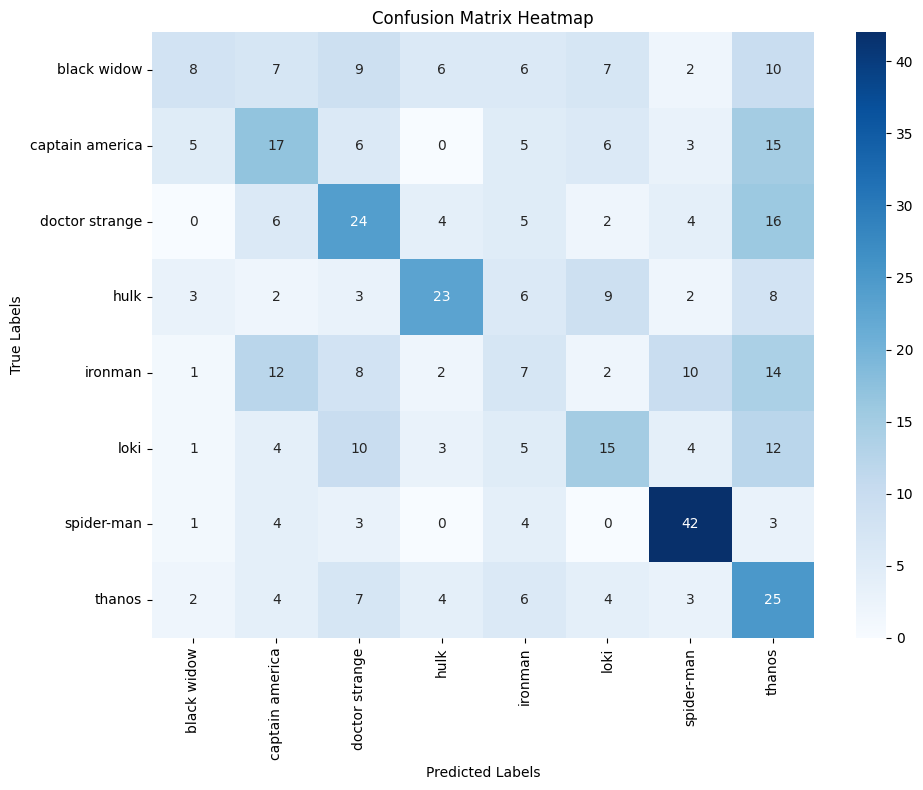

In [33]:
y_true = test_dataset.classes
y_pred_probs = baseline_sgd_model.predict(test_dataset)
y_pred = np.argmax(y_pred_probs, axis=1)

# Compute confusion matrix
cm = confusion_matrix(y_true, y_pred)

# Plot the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=True,
            xticklabels=test_dataset.class_indices.keys(),
            yticklabels=test_dataset.class_indices.keys())
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix Heatmap')
plt.tight_layout()
plt.show()

> In the above confusion matrix we can observe that the most well predicted classe is "spider-man". Some more observations
- We can see that "thanos" class is being well predicted as well but, other classes are being heavily confused with the thanos class which might be due to the noise in the dataset images. (or the colorful infinity stones present in thanos's images)
- Hulk and Spiderman are being rightly classified as compared to other classes.
- We can see high confusion in classification between ironman, captain america, black widow and thanos.

In [34]:
test_loss, test_accuracy = baseline_adam_model.evaluate(test_dataset)

print(f"Test Loss: {test_loss:.4f}")
print(f"Test Accuracy: {test_accuracy:.4f}")

15/15 ━━━━━━━━━━━━━━━━━━━━ 5s 300ms/step - accuracy: 0.2983 - loss: 2.0875
Test Loss: 1.9647
Test Accuracy: 0.3437


> Here we can see the accuracy of the model in testing dataset, i.e. 34.37% accuracy

In [35]:
y_true = test_dataset.classes
y_pred_probs = baseline_adam_model.predict(test_dataset)
y_pred = np.argmax(y_pred_probs, axis=1)

class_names = list(test_dataset.class_indices.keys())

print(classification_report(y_true, y_pred, target_names=class_names))

15/15 ━━━━━━━━━━━━━━━━━━━━ 6s 403ms/step
                 precision    recall  f1-score   support

    black widow       0.23      0.24      0.23        55
captain america       0.28      0.18      0.22        57
 doctor strange       0.28      0.44      0.34        61
           hulk       0.43      0.41      0.42        56
        ironman       0.25      0.20      0.22        56
           loki       0.27      0.20      0.23        54
     spider-man       0.72      0.68      0.70        57
         thanos       0.30      0.38      0.34        55

       accuracy                           0.34       451
      macro avg       0.34      0.34      0.34       451
   weighted avg       0.35      0.34      0.34       451



> We can observe the classification report of the baseline model using sgd optimizers and gain the following insights:
- From the precision, we can determine how many of the model’s positive predictions were actually correct. The model achieved an average precision of 34%.
- From the recall, we see how many actual positive instances the model was able to correctly identify. The model achieved an average recall of 34%.
- The f1-score, which balances precision and recall, also averaged around 34%, indicating modest but balanced performance.

Among the classes, spider-man again stands out with the highest precision (0.72), recall (0.68), and f1-score (0.70), while other classes like ironman and loki lag behind, showing significant variance in predictive accuracy across classes.

15/15 ━━━━━━━━━━━━━━━━━━━━ 4s 287ms/step


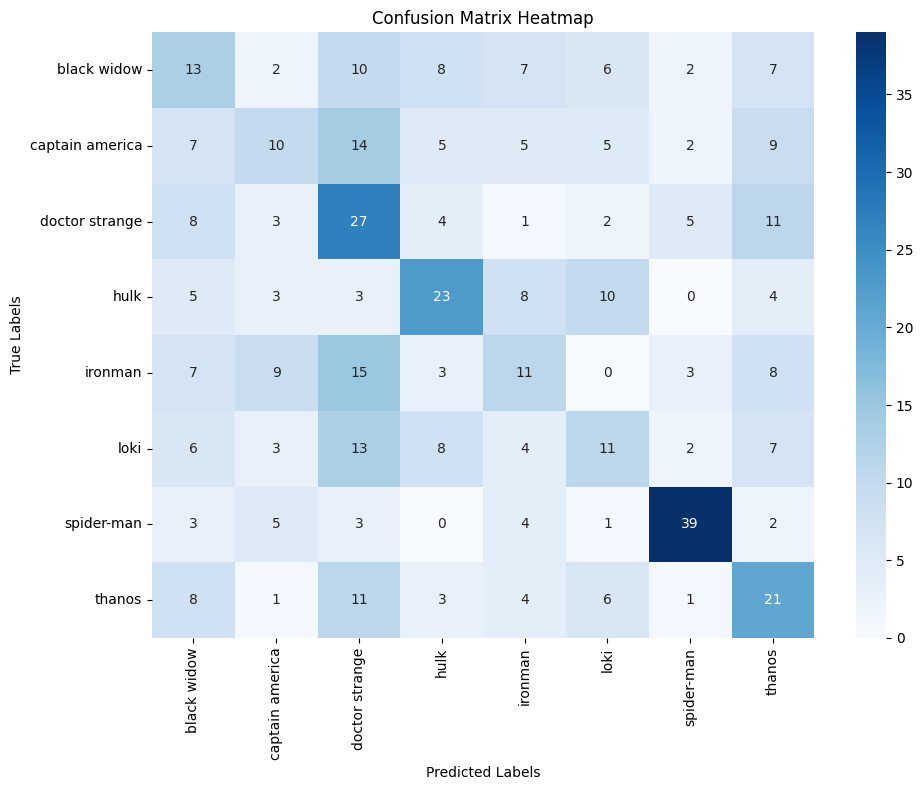

In [36]:
y_true = test_dataset.classes
y_pred_probs = baseline_adam_model.predict(test_dataset)
y_pred = np.argmax(y_pred_probs, axis=1)

# Compute confusion matrix
cm = confusion_matrix(y_true, y_pred)

# Plot the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=True,
            xticklabels=test_dataset.class_indices.keys(),
            yticklabels=test_dataset.class_indices.keys())
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix Heatmap')
plt.tight_layout()
plt.show()

> Here, we can see the confusion matrix where correctly and incorrectly predicted classes are visualized. The class that is most correctly predicted is "spider-man", with 39 accurate predictions out of 57, which aligns with its strong f1-score of 0.70 in the classification report.

> On the other hand, the class with the most widespread false predictions is "ironman"—its predictions are distributed across many other classes (notably 15 predicted as "doctor strange", 11 as "loki", 8 as "black widow", among others).

This indicates that the model frequently confuses "ironman" with multiple other characters, likely due to feature overlap, limited training samples, or insufficient class separation in the learned feature space.

###Design, Train and Evaluate Deeper Architecture with Regularization Layer

####Model Architecture

In [37]:
input_shape = (224, 224, 3)
num_classes = 8

deeper_sgd_model = Sequential([
    Conv2D(32, (3, 3), activation='relu', kernel_regularizer=l2(0.001), input_shape=input_shape),
    Conv2D(32, (3, 3), activation='relu', kernel_regularizer=l2(0.001)),
    MaxPooling2D(2, 2),

    Conv2D(64, (3, 3), activation='relu', kernel_regularizer=l2(0.001)),
    Conv2D(64, (3, 3), activation='relu', kernel_regularizer=l2(0.001)),
    MaxPooling2D(2, 2),

    Conv2D(128, (3, 3), activation='relu', kernel_regularizer=l2(0.001)),
    Conv2D(128, (3, 3), activation='relu', kernel_regularizer=l2(0.001)),
    MaxPooling2D(2, 2),

    Conv2D(256, (3, 3), activation='relu', kernel_regularizer=l2(0.001)),
    Conv2D(256, (3, 3), activation='relu', kernel_regularizer=l2(0.001)),
    MaxPooling2D(2, 2),

    Flatten(),

    Dense(256, activation='relu', kernel_regularizer=l2(0.001)),
    Dropout(0.4),
    Dense(128, activation='relu', kernel_regularizer=l2(0.001)),
    Dropout(0.3),
    Dense(64, activation='relu', kernel_regularizer=l2(0.001)),
    Dense(num_classes, activation='softmax')
])

deeper_sgd_model.summary()


/Users/grumpyyy/.pyenv/versions/3.10.11/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_6 (Conv2D)               │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 220, 220, 32)   │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_6 (MaxPooling2D)  │ (None, 110, 110, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_8 (Conv2D)               │ (None, 108, 108, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 106, 106, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_7 (MaxPooling2D)  │ (None, 53, 53, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_10 (Conv2D)              │ (None, 51, 51, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_11 (Conv2D)              │ (None, 49, 49, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_8 (MaxPooling2D)  │ (None, 24, 24, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_12 (Conv2D)              │ (None, 22, 22, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_13 (Conv2D)              │ (None, 20, 20, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_9 (MaxPooling2D)  │ (None, 10, 10, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 25600)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 256)            │     6,553,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_10 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_11 (Dense)                │ (None, 8)              │           520 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 7,767,784 (29.63 MB)

 Trainable params: 7,767,784 (29.63 MB)

 Non-trainable params: 0 (0.00 B)

> This is the deeper model using the SGD optimizer. Here we can see the model's architecture.

> Here there are total of 19 layers where there are:
- Conv2D layer: 8
- MaxPooling Layer: 3
- Flatten Layer: 1
- Fully Connected Layers: 4
- Dropout Layer: 2
- Output Dense Layer with Softmax Activation Function: 1

In [38]:
input_shape = (224, 224, 3)
num_classes = 8

deeper_sgd_model_2 = Sequential([
    Conv2D(32, (3, 3), activation='relu', kernel_regularizer=l2(0.0005), input_shape=input_shape),
    BatchNormalization(),
    Conv2D(32, (3, 3), activation='relu', kernel_regularizer=l2(0.0005)),
    BatchNormalization(),
    MaxPooling2D(2, 2),

    Conv2D(64, (3, 3), activation='relu', kernel_regularizer=l2(0.0005)),
    BatchNormalization(),
    Conv2D(64, (3, 3), activation='relu', kernel_regularizer=l2(0.0005)),
    BatchNormalization(),
    MaxPooling2D(2, 2),

    Conv2D(128, (3, 3), activation='relu', kernel_regularizer=l2(0.0005)),
    BatchNormalization(),
    Conv2D(128, (3, 3), activation='relu', kernel_regularizer=l2(0.0005)),
    BatchNormalization(),
    MaxPooling2D(2, 2),

    Conv2D(256, (3, 3), activation='relu', kernel_regularizer=l2(0.0005)),
    BatchNormalization(),
    Conv2D(256, (3, 3), activation='relu', kernel_regularizer=l2(0.0005)),
    BatchNormalization(),
    MaxPooling2D(2, 2),

    Flatten(),

    Dense(256, activation='relu', kernel_regularizer=l2(0.0005)),
    BatchNormalization(),
    Dropout(0.3),

    Dense(128, activation='relu', kernel_regularizer=l2(0.0005)),
    BatchNormalization(),
    Dropout(0.2),

    Dense(64, activation='relu', kernel_regularizer=l2(0.0005)),
    BatchNormalization(),

    Dense(num_classes, activation='softmax')
])

deeper_sgd_model_2.summary()


Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_14 (Conv2D)              │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 222, 222, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_15 (Conv2D)              │ (None, 220, 220, 32)   │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 220, 220, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_10 (MaxPooling2D) │ (None, 110, 110, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_16 (Conv2D)              │ (None, 108, 108, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 108, 108, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_17 (Conv2D)              │ (None, 106, 106, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 106, 106, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_11 (MaxPooling2D) │ (None, 53, 53, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_18 (Conv2D)              │ (None, 51, 51, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 51, 51, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_19 (Conv2D)              │ (None, 49, 49, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 49, 49, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_12 (MaxPooling2D) │ (None, 24, 24, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_20 (Conv2D)              │ (None, 22, 22, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 22, 22, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_21 (Conv2D)              │ (None, 20, 20, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 20, 20, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_13 (MaxPooling2D) │ (None, 10, 10, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_3 (Flatten)             │ (None, 25600)          │             

 Total params: 7,773,416 (29.65 MB)

 Trainable params: 7,770,600 (29.64 MB)

 Non-trainable params: 2,816 (11.00 KB)

> This is the second deeper model using the SGD optimizer. Here we can see the model's architecture.

> Here there are total of 19 layers where there are:
- Conv2D layer: 8
- MaxPooling Layer: 4
- Batch Normalization: 11
- Flatten Layer: 1
- Fully Connected Layers: 3
- Dropout Layer: 2
- Output Dense Layer with Softmax Activation Function: 1

In [39]:
input_shape = (224, 224, 3)
num_classes = 8

deeper_adam_model = Sequential([
    Conv2D(32, (3, 3), activation='relu', kernel_regularizer=l2(0.0005), input_shape=input_shape),
    BatchNormalization(),
    Conv2D(32, (3, 3), activation='relu', kernel_regularizer=l2(0.0005)),
    BatchNormalization(),
    MaxPooling2D(2, 2),

    Conv2D(64, (3, 3), activation='relu', kernel_regularizer=l2(0.0005)),
    BatchNormalization(),
    Conv2D(64, (3, 3), activation='relu', kernel_regularizer=l2(0.0005)),
    BatchNormalization(),
    MaxPooling2D(2, 2),

    Conv2D(128, (3, 3), activation='relu', kernel_regularizer=l2(0.0005)),
    BatchNormalization(),
    Conv2D(128, (3, 3), activation='relu', kernel_regularizer=l2(0.0005)),
    BatchNormalization(),
    MaxPooling2D(2, 2),

    Conv2D(256, (3, 3), activation='relu', kernel_regularizer=l2(0.0005)),
    BatchNormalization(),
    Conv2D(256, (3, 3), activation='relu', kernel_regularizer=l2(0.0005)),
    BatchNormalization(),
    MaxPooling2D(2, 2),

    Flatten(),

    Dense(256, activation='relu', kernel_regularizer=l2(0.0005)),
    BatchNormalization(),
    Dropout(0.3),

    Dense(128, activation='relu', kernel_regularizer=l2(0.0005)),
    BatchNormalization(),
    Dropout(0.2),

    Dense(64, activation='relu', kernel_regularizer=l2(0.0005)),
    BatchNormalization(),

    Dense(num_classes, activation='softmax')
])

deeper_adam_model.summary()


Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_22 (Conv2D)              │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_11          │ (None, 222, 222, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_23 (Conv2D)              │ (None, 220, 220, 32)   │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_12          │ (None, 220, 220, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_14 (MaxPooling2D) │ (None, 110, 110, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_24 (Conv2D)              │ (None, 108, 108, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_13          │ (None, 108, 108, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_25 (Conv2D)              │ (None, 106, 106, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_14          │ (None, 106, 106, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_15 (MaxPooling2D) │ (None, 53, 53, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_26 (Conv2D)              │ (None, 51, 51, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_15          │ (None, 51, 51, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_27 (Conv2D)              │ (None, 49, 49, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_16          │ (None, 49, 49, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_16 (MaxPooling2D) │ (None, 24, 24, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_28 (Conv2D)              │ (None, 22, 22, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_17          │ (None, 22, 22, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_29 (Conv2D)              │ (None, 20, 20, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_18          │ (None, 20, 20, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_17 (MaxPooling2D) │ (None, 10, 10, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_4 (Flatten)             │ (None, 25600)          │             

 Total params: 7,773,416 (29.65 MB)

 Trainable params: 7,770,600 (29.64 MB)

 Non-trainable params: 2,816 (11.00 KB)

> This is the second deeper model using the Adam optimizer. Here we can see the model's architecture.

> Here there are total of 19 layers where there are:
- Conv2D layer: 8
- MaxPooling Layer: 4
- Batch Normalization: 11
- Flatten Layer: 1
- Fully Connected Layers: 3
- Dropout Layer: 2
- Output Dense Layer with Softmax Activation Function: 1

####Model Training

#####SGD Optimizer

In [40]:
deeper_sgd_model.compile(
    optimizer=SGD(learning_rate=0.001, momentum=0.9), #setting the learning rate and the momentum (it helps in faster convergence and controls extreme oscillations)
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

In [41]:
callbacks_sgd = [
    ModelCheckpoint("deeper_sgd_model.keras", save_best_only=True, monitor="val_accuracy", mode="max"),
    EarlyStopping(monitor="val_loss", patience=10, restore_best_weights=True),
    ReduceLROnPlateau(monitor="val_loss", factor=0.5, patience=3, min_lr=1e-5)
]

history_deeper_sgd = deeper_sgd_model.fit(
    training_dataset,
    validation_data=validation_dataset,
    epochs=50,
    callbacks=callbacks_sgd
)


Epoch 1/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 423s 6s/step - accuracy: 0.1189 - loss: 3.6257 - val_accuracy: 0.1323 - val_loss: 3.6224 - learning_rate: 0.0010
Epoch 2/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 387s 6s/step - accuracy: 0.1188 - loss: 3.6218 - val_accuracy: 0.1342 - val_loss: 3.6182 - learning_rate: 0.0010
Epoch 3/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 395s 6s/step - accuracy: 0.1278 - loss: 3.6176 - val_accuracy: 0.1342 - val_loss: 3.6141 - learning_rate: 0.0010
Epoch 4/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 372s 6s/step - accuracy: 0.1404 - loss: 3.6135 - val_accuracy: 0.1342 - val_loss: 3.6102 - learning_rate: 0.0010
Epoch 5/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 368s 6s/step - accuracy: 0.1362 - loss: 3.6093 - val_accuracy: 0.1342 - val_loss: 3.6060 - learning_rate: 0.0010
Epoch 6/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 365s 6s/step - accuracy: 0.1285 - loss: 3.6056 - val_accuracy: 0.1342 - val_loss: 3.6020 - learning_rate: 0.0010
Epoch 7/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 367s 6s/step - accuracy: 0.1145 - loss: 3.6020 - val_acc

> In the training of the first SGD deeper model, we've set the epochs to 50.

From the logs, we can observe that:

The training starts with a very low accuracy of 0.1189 and high validation loss of 3.6224.

As training progresses, we do observe incremental improvements in both accuracy and validation loss, but the rate of change is extremely slow.

By epoch 25, the accuracy reaches only ~0.24, and the validation loss slowly drops to around 3.53, showing minimal improvement.

After epoch 30, although the model continues to train, the improvement rate remains sluggish. There’s no strong sign of convergence even after 50 epochs.

At the final epoch (50):

Training accuracy is 0.2469

Validation accuracy is 0.3463

Validation loss is still relatively high at 3.2285

This behavior indicates that the model is learning very slowly, potentially due to limitations in the optimizer configuration or network architecture. The slow convergence suggests that either:

The learning rate is too low.

The architecture needs additional regularization techniques or complexity tuning.

Overall, this setup is not optimal for efficient convergence and would benefit from hyperparameter tuning or architectural enhancements.

In [42]:
deeper_sgd_model_2.compile(
    optimizer=SGD(learning_rate=0.001, momentum=0.9),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

In [43]:
callbacks_sgd_2 = [
    ModelCheckpoint("deeper_sgd_model.keras", save_best_only=True, monitor="val_accuracy", mode="max"),
    EarlyStopping(monitor="val_loss", patience=10, restore_best_weights=True),
    ReduceLROnPlateau(monitor="val_loss", factor=0.5, patience=3, min_lr=1e-5)
]

history_deeper_sgd = deeper_sgd_model_2.fit(
    training_dataset,
    validation_data=validation_dataset,
    epochs=50,
    callbacks=callbacks_sgd_2
)


Epoch 1/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 532s 8s/step - accuracy: 0.1390 - loss: 3.4687 - val_accuracy: 0.1498 - val_loss: 2.9597 - learning_rate: 0.0010
Epoch 2/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 551s 8s/step - accuracy: 0.1746 - loss: 3.0506 - val_accuracy: 0.1342 - val_loss: 2.9901 - learning_rate: 0.0010
Epoch 3/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 527s 8s/step - accuracy: 0.2096 - loss: 2.9946 - val_accuracy: 0.1381 - val_loss: 3.0878 - learning_rate: 0.0010
Epoch 4/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 510s 8s/step - accuracy: 0.2398 - loss: 2.8619 - val_accuracy: 0.1615 - val_loss: 3.0137 - learning_rate: 0.0010
Epoch 5/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 529s 8s/step - accuracy: 0.2442 - loss: 2.7965 - val_accuracy: 0.1848 - val_loss: 2.8928 - learning_rate: 5.0000e-04
Epoch 6/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 553s 9s/step - accuracy: 0.2533 - loss: 2.7434 - val_accuracy: 0.2412 - val_loss: 2.7589 - learning_rate: 5.0000e-04
Epoch 7/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 536s 8s/step - accuracy: 0.2692 - loss: 2.6871 -

> In the second deeper sgd model we've set the epoch to 50. We can see that the convergence of the model has significantly increased in this second model after adding batch normalization.

>The second deeper model's convergence occurs around 38 epoch where the accuracy is 0.5469 and the validation accuracy is 0.5486 with validation loss of 2.0758

#####Adam Optimizer

In [44]:
deeper_adam_model.compile(optimizer=Adam(learning_rate=0.0005),
                         loss='sparse_categorical_crossentropy',
                         metrics=['accuracy'])

In [45]:
callbacks_adam = [
    ModelCheckpoint("deeper_adam_model.keras", save_best_only=True, monitor="val_accuracy", mode="max"),
    EarlyStopping(monitor="val_loss", patience=10, restore_best_weights=True),
    ReduceLROnPlateau(monitor="val_loss", factor=0.5, patience=3, min_lr=1e-5)
]

history_deeper_adam = deeper_adam_model.fit(
    training_dataset,
    validation_data=validation_dataset,
    epochs=50,
    callbacks=callbacks_adam
)


Epoch 1/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 294s 4s/step - accuracy: 0.1556 - loss: 3.3333 - val_accuracy: 0.1245 - val_loss: 3.5300 - learning_rate: 5.0000e-04
Epoch 2/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 588s 9s/step - accuracy: 0.2182 - loss: 2.9624 - val_accuracy: 0.1226 - val_loss: 3.3317 - learning_rate: 5.0000e-04
Epoch 3/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 525s 8s/step - accuracy: 0.2437 - loss: 2.8439 - val_accuracy: 0.1226 - val_loss: 3.2675 - learning_rate: 5.0000e-04
Epoch 4/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 570s 9s/step - accuracy: 0.2536 - loss: 2.7719 - val_accuracy: 0.1323 - val_loss: 3.0433 - learning_rate: 5.0000e-04
Epoch 5/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 556s 9s/step - accuracy: 0.2936 - loss: 2.6758 - val_accuracy: 0.1634 - val_loss: 2.9901 - learning_rate: 5.0000e-04
Epoch 6/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 537s 8s/step - accuracy: 0.3199 - loss: 2.6280 - val_accuracy: 0.3016 - val_loss: 2.7080 - learning_rate: 5.0000e-04
Epoch 7/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 538s 8s/step - accuracy: 0.3302 

> In the deeper Adam model, we set the epoch count to 50. By epoch 40, the model achieved a training accuracy of 0.7660 and a validation loss of 1.7052, with a validation accuracy of 0.6693. At epoch 50, the training accuracy reached 0.7981, and the validation accuracy was 0.6459, with a validation loss of 1.7281. We increased the number of epochs compared to the SGD model due to Adam's lower initial learning rate and slower convergence. The ReduceLROnPlateau callback effectively reduced the learning rate from 5e-4 down to 1e-5 as the validation loss plateaued, helping the model refine its performance in later stages.

####Model Evaluation

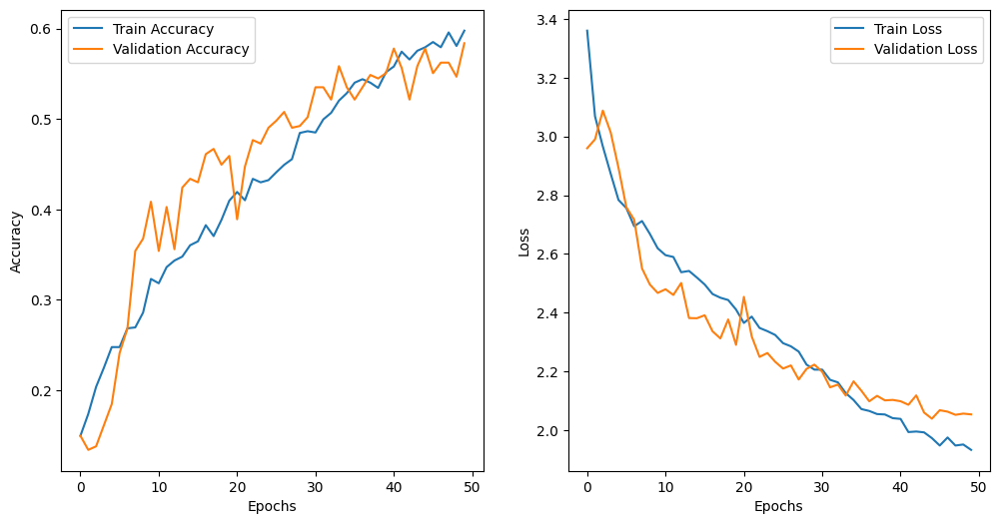

In [46]:
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(history_deeper_sgd.history['accuracy'], label='Train Accuracy')
plt.plot(history_deeper_sgd.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history_deeper_sgd.history['loss'], label='Train Loss')
plt.plot(history_deeper_sgd.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.show()

> The the above two plots we can see the training and validation accuracy and training and validation loss.

>In the plot we can see a very good pattern showing in the accuracies and losses, the accuracies are increase in a very good steady pace and the losses are also decreasing in a steady pace with no signs of overfitting.

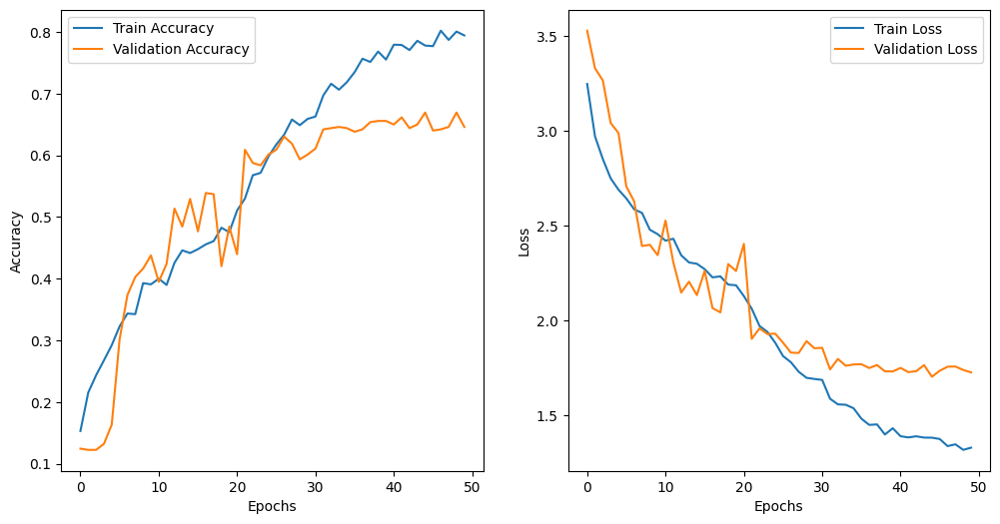

In [47]:
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(history_deeper_adam.history['accuracy'], label='Train Accuracy')
plt.plot(history_deeper_adam.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history_deeper_adam.history['loss'], label='Train Loss')
plt.plot(history_deeper_adam.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.show()

> In the accuracy and loss plot of the deeper adam model, we can notice that the accuracy and the loss increase and decrease at a steady pace. But in the adam opmitimizer we can clearly see that the convergence occurs faster than then the SGD model.

>After around 38th epoch we can see that even if the validation accuracy and the training accuracy is increasing, the validation loss is not decreasing

In [48]:
test_loss, test_accuracy = deeper_sgd_model_2.evaluate(test_dataset)

print(f"Test Loss: {test_loss:.4f}")
print(f"Test Accuracy: {test_accuracy:.4f}")

15/15 ━━━━━━━━━━━━━━━━━━━━ 20s 1s/step - accuracy: 0.3478 - loss: 2.6635
Test Loss: 2.4673
Test Accuracy: 0.4124


> We can see the accuracy of the deeper sgd model in the testing data i.e. 41% accuracy

In [49]:
y_true = test_dataset.classes
y_pred_probs = deeper_sgd_model_2.predict(test_dataset)
y_pred = np.argmax(y_pred_probs, axis=1)

class_names = list(test_dataset.class_indices.keys())

print(classification_report(y_true, y_pred, target_names=class_names))

15/15 ━━━━━━━━━━━━━━━━━━━━ 26s 2s/step
                 precision    recall  f1-score   support

    black widow       0.33      0.27      0.30        55
captain america       0.25      0.25      0.25        57
 doctor strange       0.38      0.33      0.35        61
           hulk       0.59      0.54      0.56        56
        ironman       0.33      0.36      0.34        56
           loki       0.45      0.33      0.38        54
     spider-man       0.67      0.74      0.70        57
         thanos       0.33      0.49      0.39        55

       accuracy                           0.41       451
      macro avg       0.42      0.41      0.41       451
   weighted avg       0.42      0.41      0.41       451



> Here we can properly see the classification report of the deeper sgd model.
- The best performing class is spider-man, with a precision of 0.67, recall of 0.74, and f1-score of 0.70, indicating strong predictive performance for this class.
- The worst performing class is captain america, with a precision of 0.25, recall of 0.25, and f1-score of 0.25.
- The overall accuracy of the model is 0.41, with both macro and weighted average f1-scores of 0.41, suggesting consistent performance across classes.
- We can also observe that there isn’t significant data imbalance, as most classes have similar support and are classified with relatively close performance metrics.

15/15 ━━━━━━━━━━━━━━━━━━━━ 18s 1s/step


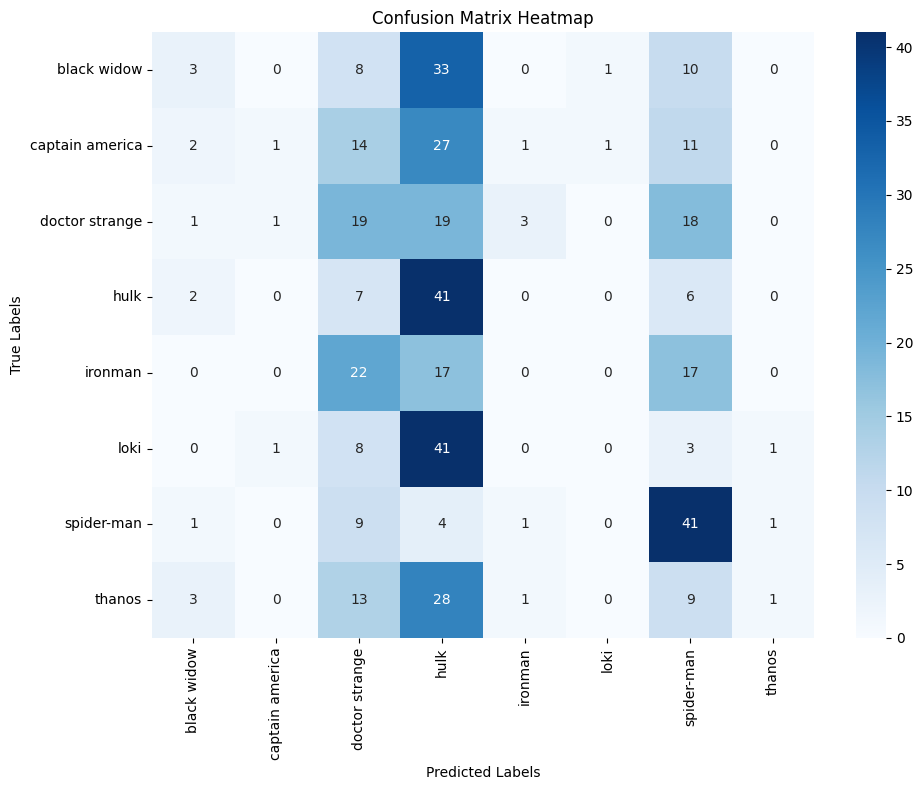

In [50]:
y_true = test_dataset.classes
y_pred_probs = deeper_sgd_model.predict(test_dataset)
y_pred = np.argmax(y_pred_probs, axis=1)

cm = confusion_matrix(y_true, y_pred)

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=True,
            xticklabels=test_dataset.class_indices.keys(),
            yticklabels=test_dataset.class_indices.keys())
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix Heatmap')
plt.tight_layout()
plt.show()

> In the heatmap, we observe patterns consistent with the earlier classification report. The most correctly predicted class is spider-man, with 41 correct predictions. This indicates the model has high confidence and consistency in identifying this class.

> The least correctly predicted class is black widow, with only 3 correct predictions and a significant number of misclassifications, especially being confused with ironman (33 instances). This highlights areas for potential improvement in class separability for visually similar categories.

15/15 ━━━━━━━━━━━━━━━━━━━━ 27s 2s/step


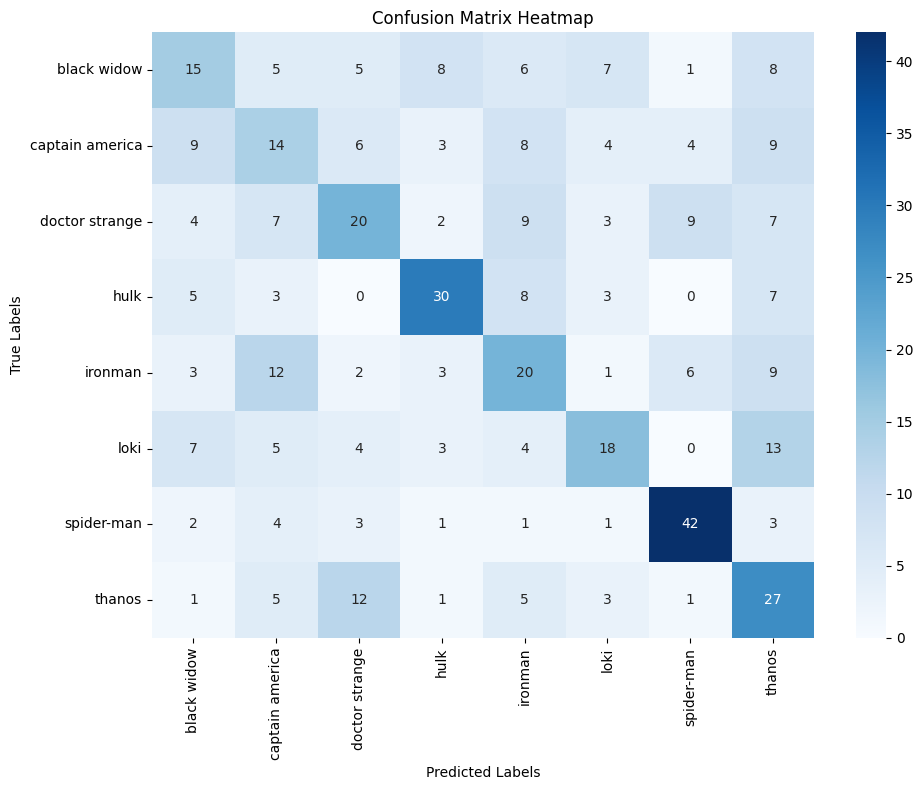

In [51]:
y_true = test_dataset.classes
y_pred_probs = deeper_sgd_model_2.predict(test_dataset)
y_pred = np.argmax(y_pred_probs, axis=1)

cm = confusion_matrix(y_true, y_pred)

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=True,
            xticklabels=test_dataset.class_indices.keys(),
            yticklabels=test_dataset.class_indices.keys())
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix Heatmap')
plt.tight_layout()
plt.show()

> In the heatmap, we can see the similar patterns from the baseline models, i.e., the most correctly predicted class is spider-man with 42 correct predictions.

> The worst predicted class in here turned out to be captain america.

> In the heatmap, we can see that the correct predictions have improved compared to the last heatmap observations.

In [52]:
test_loss, test_accuracy = deeper_adam_model.evaluate(test_dataset)

print(f"Test Loss: {test_loss:.4f}")
print(f"Test Accuracy: {test_accuracy:.4f}")

15/15 ━━━━━━━━━━━━━━━━━━━━ 20s 1s/step - accuracy: 0.4293 - loss: 2.6494
Test Loss: 2.4218
Test Accuracy: 0.4701


> Here we can see the test accuracy of the deeper adam model of around 47% which is the highest among the other baseline and deeper sgd models.

In [53]:
y_true = test_dataset.classes
y_pred_probs = deeper_adam_model.predict(test_dataset)
y_pred = np.argmax(y_pred_probs, axis=1)

class_names = list(test_dataset.class_indices.keys())

print(classification_report(y_true, y_pred, target_names=class_names))

15/15 ━━━━━━━━━━━━━━━━━━━━ 24s 2s/step
                 precision    recall  f1-score   support

    black widow       0.31      0.36      0.34        55
captain america       0.42      0.37      0.39        57
 doctor strange       0.48      0.43      0.45        61
           hulk       0.61      0.55      0.58        56
        ironman       0.43      0.34      0.38        56
           loki       0.47      0.46      0.47        54
     spider-man       0.62      0.68      0.65        57
         thanos       0.43      0.56      0.49        55

       accuracy                           0.47       451
      macro avg       0.47      0.47      0.47       451
   weighted avg       0.47      0.47      0.47       451



> Here we can also see classification report of the deeper adam model

> Following the previous pattern, the most correctly predicted class is spider-man, which has a precision of 0.62, recall of 0.68, and f1-score of 0.65.

> We can also see noticalble improvement in the prediction of all the other classes.

15/15 ━━━━━━━━━━━━━━━━━━━━ 22s 2s/step


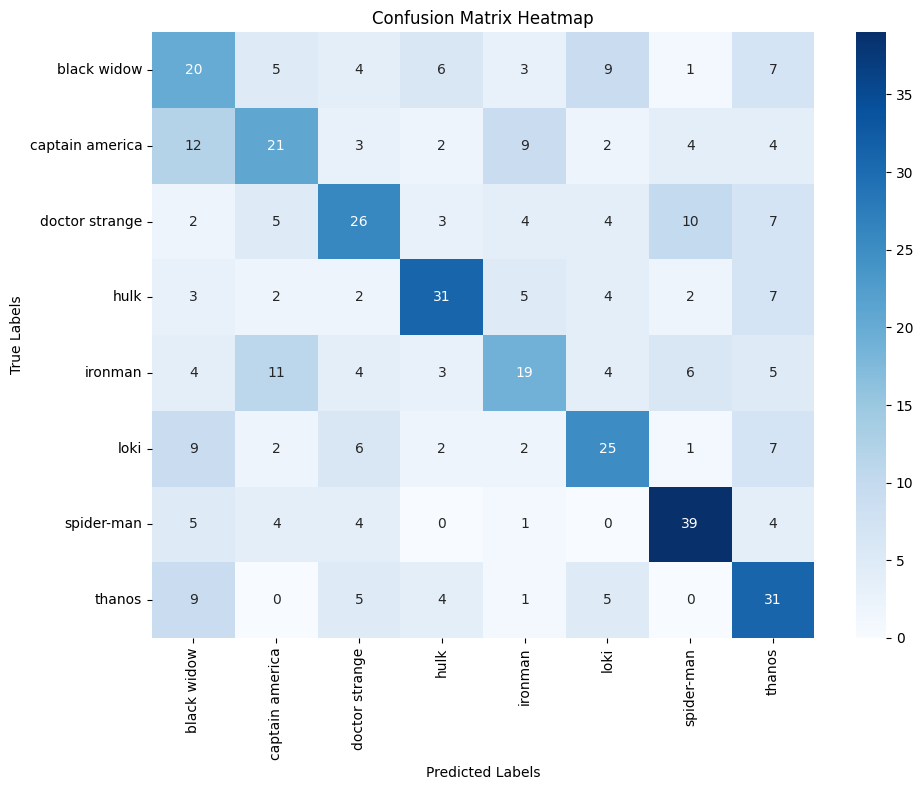

In [54]:
y_true = test_dataset.classes
y_pred_probs = deeper_adam_model.predict(test_dataset)
y_pred = np.argmax(y_pred_probs, axis=1)

cm = confusion_matrix(y_true, y_pred)

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=True,
            xticklabels=test_dataset.class_indices.keys(),
            yticklabels=test_dataset.class_indices.keys())
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix Heatmap')
plt.tight_layout()
plt.show()

> In the heatmap of the deeper Adam model, we can see that the most correctly predicted class is spider-man with 39 correct classifications.

> The least correctly predicted class is black widow, with 20 correct predictions, despite moderate distribution across other classes.

> We also observe that while thanos had 31 correct predictions, it showed a higher spread of misclassifications, making it one of the more frequently confused classes.


###Experimentation and Comparative Analysis

####Baseline vs Deeper Model Performance Comparision

In [55]:
loaded_baseline_sgd_model = load_model("baseline_sgd_model.keras")
loaded_baseline_adam_model = load_model("baseline_adam_model.keras")



loaded_deeper_sgd_model = load_model("deeper_sgd_model.keras")
loaded_deeper_adam_model = load_model("deeper_adam_model.keras")

> We are loading the model that we saved at the time of training using the ModelCheckPoint callback using the keras load_modal function.

In [56]:
baseline_sgd_loss, baseline_sgd_acc = loaded_baseline_sgd_model.evaluate(test_dataset)
print(f"Baseline sgd model - Accuracy: {baseline_sgd_acc:.4f}, Loss: {baseline_sgd_loss:.4f}")

baseline_adam_loss, baseline_adam_acc = loaded_baseline_adam_model.evaluate(test_dataset)
print(f"Baseline Adam model - Accuracy: {baseline_adam_acc:.4f}, Loss: {baseline_adam_loss:.4f}")

15/15 ━━━━━━━━━━━━━━━━━━━━ 6s 357ms/step - accuracy: 0.2912 - loss: 2.0041
Baseline sgd model - Accuracy: 0.3570, Loss: 1.8004
15/15 ━━━━━━━━━━━━━━━━━━━━ 7s 462ms/step - accuracy: 0.3279 - loss: 2.7525
Baseline Adam model - Accuracy: 0.3659, Loss: 2.5195


> Here we can see that the baseline sgd model is out performing the baseline adman model because in the baseline adam model we could see that the model was overfitting and it was unable to generalize well.

In [57]:
deeper_sgd_loss, deeper_sgd_acc = loaded_deeper_sgd_model.evaluate(test_dataset)
print(f"Deeper sgd model - Accuracy: {deeper_sgd_acc:.4f}, Loss: {deeper_sgd_loss:.4f}")

deeper_adam_loss, deeper_adam_acc = loaded_deeper_adam_model.evaluate(test_dataset)
print(f"Deeper Adam model - Accuracy: {deeper_adam_acc:.4f}, Loss: {deeper_adam_loss:.4f}")

15/15 ━━━━━━━━━━━━━━━━━━━━ 27s 2s/step - accuracy: 0.3521 - loss: 2.6530
Deeper sgd model - Accuracy: 0.4368, Loss: 2.4423
15/15 ━━━━━━━━━━━━━━━━━━━━ 26s 2s/step - accuracy: 0.4293 - loss: 2.6494
Deeper Adam model - Accuracy: 0.4701, Loss: 2.4218


> While comparing the deeper models we can see that the deeper adam model outperforms the deeper sgd model.

> The accuracy of the sgd model is around 43% whereas the accuracy of the deeper adam model is around 47% which is a 4% hike in accuracy which is a good sign for better generalization and performance.

In [58]:
models = {
    "Baseline SGD Model": loaded_baseline_sgd_model,
    "Baseline Adam Model": loaded_baseline_adam_model,
    "Deeper SGD Model": loaded_deeper_sgd_model,
    "Deeper Adam Model": loaded_deeper_adam_model
}

prediction_times = {}

for name, model in models.items():
    start_time = time.time()
    lets_predict_some_heroes_aye = model.predict(test_dataset)
    end_time = time.time()
    prediction_times[name] = end_time - start_time
    print(f"{name} Prediction Time: {prediction_times[name]:.4f} seconds")


15/15 ━━━━━━━━━━━━━━━━━━━━ 5s 318ms/step
Baseline SGD Model Prediction Time: 5.3218 seconds
15/15 ━━━━━━━━━━━━━━━━━━━━ 8s 508ms/step
Baseline Adam Model Prediction Time: 8.0760 seconds
15/15 ━━━━━━━━━━━━━━━━━━━━ 25s 2s/step
Deeper SGD Model Prediction Time: 25.4362 seconds
15/15 ━━━━━━━━━━━━━━━━━━━━ 26s 2s/step
Deeper Adam Model Prediction Time: 26.4715 seconds


> Here we can see the prediction or the inference time of all the loaded models, the most time taking model for prediction is the deeper sgd and adam model probably due to it's more complex architecture.

####Computational Efficiency between Baseline and Deeper Model

In [59]:
model_paths = {
    "Baseline SGD Model": "baseline_sgd_model.keras",
    "Baseline Adam Model": "baseline_adam_model.keras",
    "Deeper SGD Model": "deeper_sgd_model.keras",
    "Deeper Adam Model": "deeper_adam_model.keras"
}

for name, path in model_paths.items():
    size_mb = os.path.getsize(path) / (1024 * 1024)
    print(f"{name} Model Size: {size_mb:.2f} MB")


Baseline SGD Model Model Size: 42.69 MB
Baseline Adam Model Model Size: 127.99 MB
Deeper SGD Model Model Size: 59.43 MB
Deeper Adam Model Model Size: 89.08 MB


> Here we can see size of the loaded models. The heaviest model is the baseline adam model whereas the lightest model is the baseline sgd model.

In [60]:
models = {
    "Baseline (SGD)": loaded_baseline_sgd_model,
    "Baseline (Adam)": loaded_baseline_adam_model,
    "Deeper (SGD)": loaded_deeper_sgd_model,
    "Deeper (Adam)": loaded_deeper_adam_model
}

for name, model in models.items():
    total_params = model.count_params()
    print(f"{name} - Total Parameters: {total_params:,}")


Baseline (SGD) - Total Parameters: 11,179,560
Baseline (Adam) - Total Parameters: 11,179,560
Deeper (SGD) - Total Parameters: 7,773,416
Deeper (Adam) - Total Parameters: 7,773,416


> Here we can see that even though we have more layers in the deeper models, the total number of parameter in the deeper models are less which also show that the computational efficiency of the deeper model might be better than the baseline models.

15/15 ━━━━━━━━━━━━━━━━━━━━ 3s 192ms/step


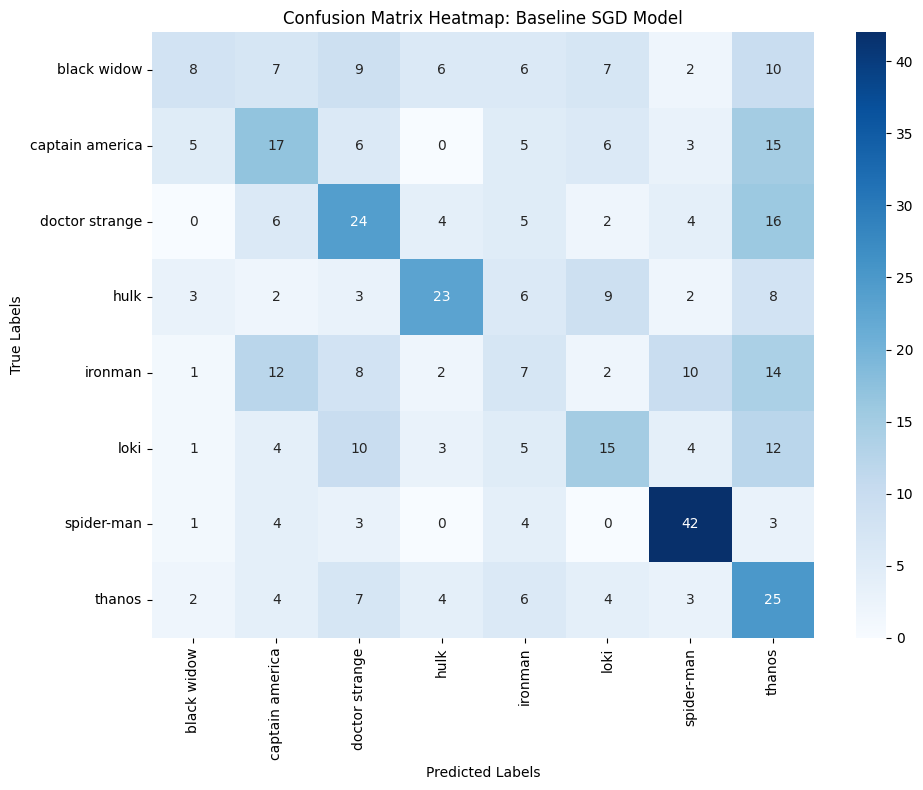

In [61]:
y_true = test_dataset.classes
y_pred_probs = loaded_baseline_sgd_model.predict(test_dataset)
y_pred = np.argmax(y_pred_probs, axis=1)

cm = confusion_matrix(y_true, y_pred)

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=True,
            xticklabels=test_dataset.class_indices.keys(),
            yticklabels=test_dataset.class_indices.keys())
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix Heatmap: Baseline SGD Model')
plt.tight_layout()
plt.show()

> Here we can see the confusion matrix of the baseline SGD model, where we can observe that the most correctly predicted class is spider-man with 42 correct predictions, whereas the worst predicted class is black widow with only 8 correct predictions.

15/15 ━━━━━━━━━━━━━━━━━━━━ 3s 181ms/step


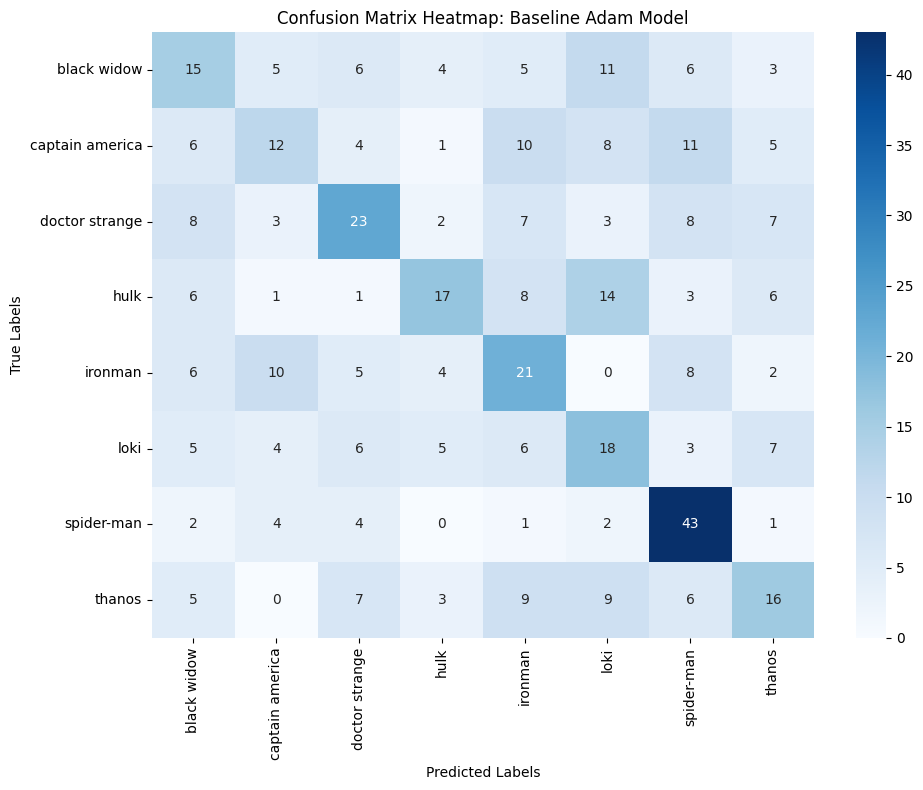

In [62]:
y_true = test_dataset.classes
y_pred_probs = loaded_baseline_adam_model.predict(test_dataset)
y_pred = np.argmax(y_pred_probs, axis=1)

cm = confusion_matrix(y_true, y_pred)

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=True,
            xticklabels=test_dataset.class_indices.keys(),
            yticklabels=test_dataset.class_indices.keys())
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix Heatmap: Baseline Adam Model')
plt.tight_layout()
plt.show()

> In the confusion matrix of the baseline adam model, we can see that the better predicted is the spiderman class. Here we can see alot of classes are mispredicted which shows the weak performance of the model in unseen data.

15/15 ━━━━━━━━━━━━━━━━━━━━ 21s 1s/step


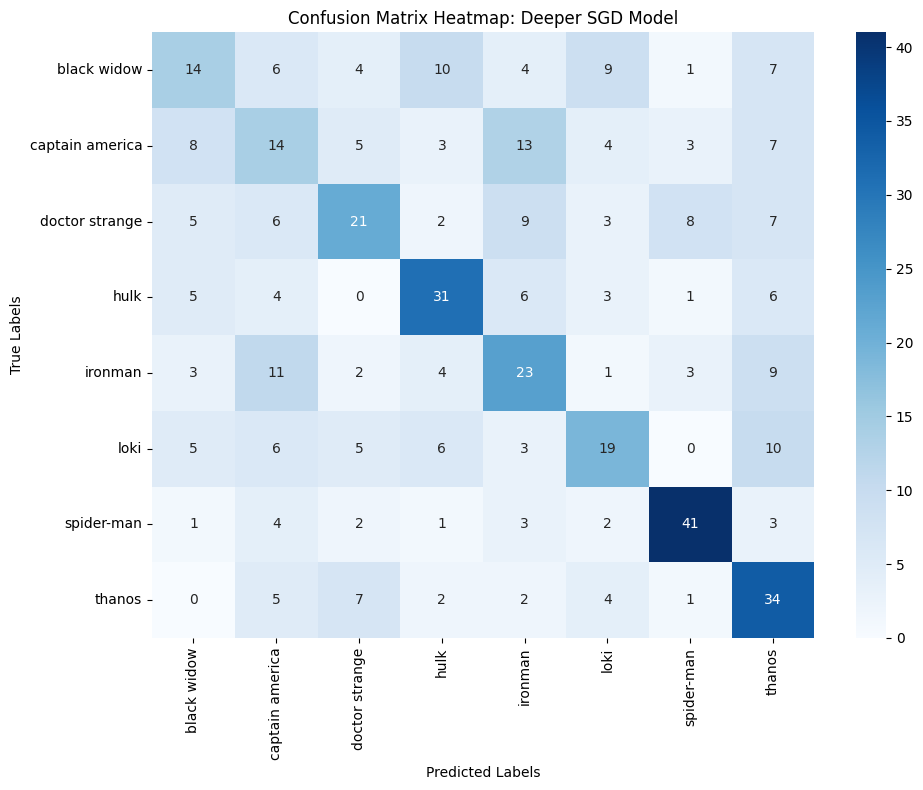

In [63]:
y_true = test_dataset.classes
y_pred_probs = loaded_deeper_sgd_model.predict(test_dataset)
y_pred = np.argmax(y_pred_probs, axis=1)

cm = confusion_matrix(y_true, y_pred)

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=True,
            xticklabels=test_dataset.class_indices.keys(),
            yticklabels=test_dataset.class_indices.keys())
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix Heatmap: Deeper SGD Model')
plt.tight_layout()
plt.show()

> In the heatmap we can see the similar patterns from the basline models i.e, the most correctly predicted class is spiderman with 41 correct predictions.

> The worst predicted class in here turned out to be captain america with only 14 correct predictions.


15/15 ━━━━━━━━━━━━━━━━━━━━ 29s 2s/step


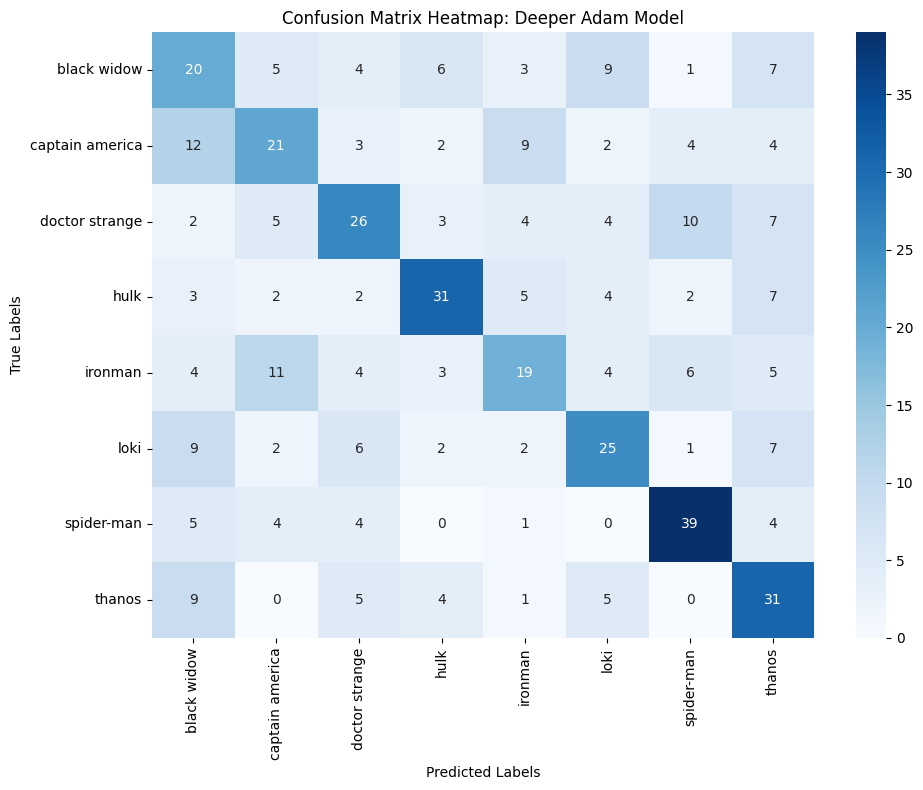

In [64]:
y_true = test_dataset.classes
y_pred_probs = loaded_deeper_adam_model.predict(test_dataset)
y_pred = np.argmax(y_pred_probs, axis=1)

cm = confusion_matrix(y_true, y_pred)

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=True,
            xticklabels=test_dataset.class_indices.keys(),
            yticklabels=test_dataset.class_indices.keys())
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix Heatmap: Deeper Adam Model')
plt.tight_layout()
plt.show()

> In the heatmap of the deeper adam model we can see that the most correctly predicted class is spiderman with 39 correct classifications.

> Whereas the class with the least correctly predicted class is black widow with only 20 correct classifications

15/15 ━━━━━━━━━━━━━━━━━━━━ 3s 202ms/step


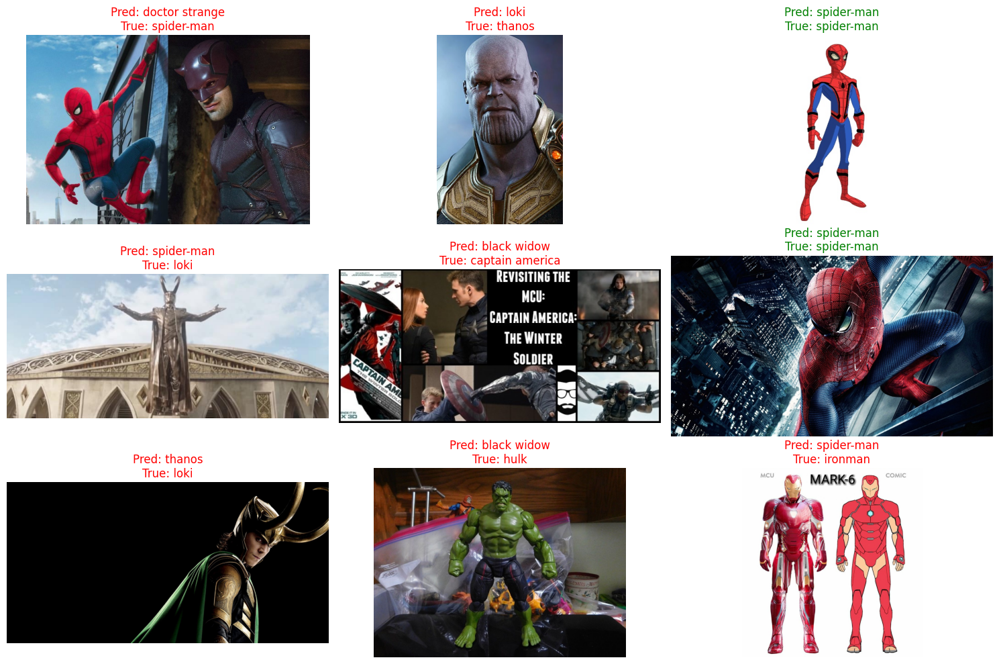

In [65]:
test_dataset.reset()

pred_probs = loaded_baseline_sgd_model.predict(test_dataset, verbose=1)
pred_classes = np.argmax(pred_probs, axis=1)
true_classes = test_dataset.classes
class_labels = list(test_dataset.class_indices.keys())

file_paths = test_dataset.filepaths

num_to_display = 9
indices = np.random.choice(len(file_paths), size=num_to_display, replace=False)

plt.figure(figsize=(15, 10))
for i, idx in enumerate(indices):
    img_path = file_paths[idx]
    img = plt.imread(img_path)

    true_label = class_labels[true_classes[idx]]
    pred_label = class_labels[pred_classes[idx]]

    plt.subplot(3, 3, i+1)
    plt.imshow(img)
    plt.axis('off')
    color = 'green' if true_label == pred_label else 'red'
    plt.title(f"Pred: {pred_label}\nTrue: {true_label}", color=color)

plt.tight_layout()
plt.show()

> Here we can see how the baseline_sgd_model is predicting on unseen test dataset. We can see that it is unable to classify superheros with greater accuracy.

15/15 ━━━━━━━━━━━━━━━━━━━━ 27s 2s/step


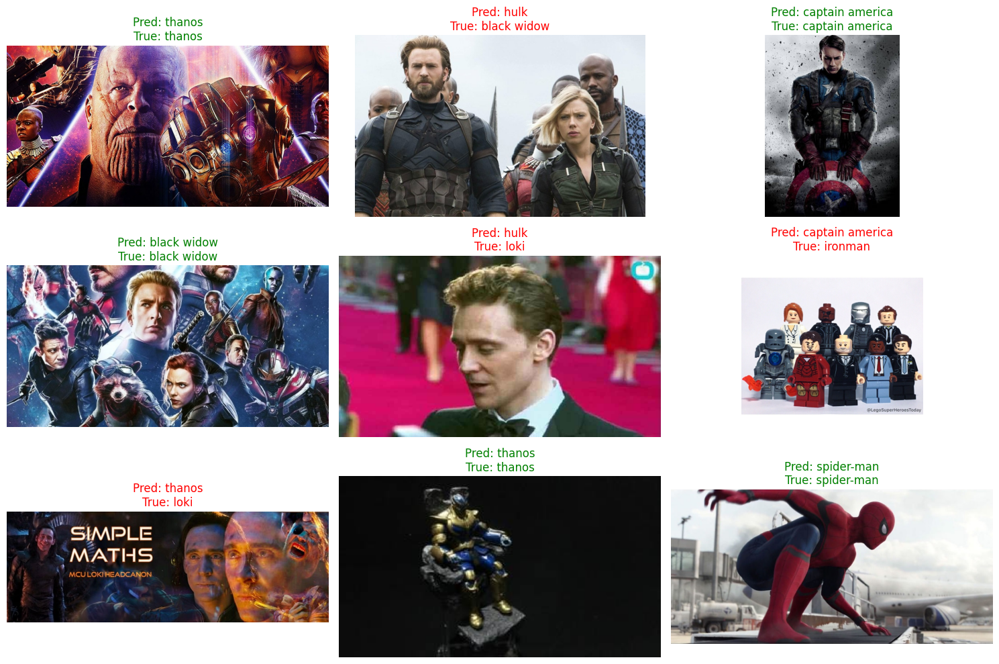

In [66]:
test_dataset.reset()

pred_probs = loaded_deeper_sgd_model.predict(test_dataset, verbose=1)
pred_classes = np.argmax(pred_probs, axis=1)
true_classes = test_dataset.classes
class_labels = list(test_dataset.class_indices.keys())

file_paths = test_dataset.filepaths

num_to_display = 9
indices = np.random.choice(len(file_paths), size=num_to_display, replace=False)

plt.figure(figsize=(15, 10))
for i, idx in enumerate(indices):
    img_path = file_paths[idx]
    img = plt.imread(img_path)

    true_label = class_labels[true_classes[idx]]
    pred_label = class_labels[pred_classes[idx]]

    plt.subplot(3, 3, i+1)
    plt.imshow(img)
    plt.axis('off')
    color = 'green' if true_label == pred_label else 'red'
    plt.title(f"Pred: {pred_label}\nTrue: {true_label}", color=color)

plt.tight_layout()
plt.show()

> Now we can see the performace of the deeper sgd model, which doesn't look much different to the baseline sgd model. But the current shown list of images look comparetively challenging than the set of images predicted by the baseline adam modal.

15/15 ━━━━━━━━━━━━━━━━━━━━ 3s 197ms/step


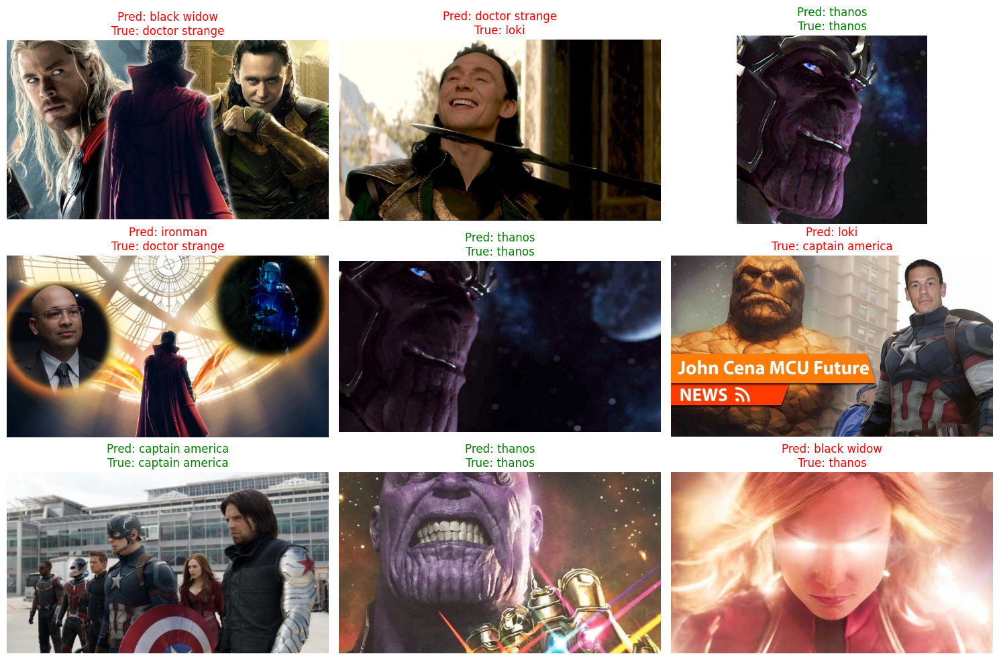

In [67]:
test_dataset.reset()

pred_probs = loaded_baseline_adam_model.predict(test_dataset, verbose=1)
pred_classes = np.argmax(pred_probs, axis=1)
true_classes = test_dataset.classes
class_labels = list(test_dataset.class_indices.keys())

file_paths = test_dataset.filepaths

num_to_display = 9
indices = np.random.choice(len(file_paths), size=num_to_display, replace=False)

plt.figure(figsize=(15, 10))
for i, idx in enumerate(indices):
    img_path = file_paths[idx]
    img = plt.imread(img_path)

    true_label = class_labels[true_classes[idx]]
    pred_label = class_labels[pred_classes[idx]]

    plt.subplot(3, 3, i+1)
    plt.imshow(img)
    plt.axis('off')
    color = 'green' if true_label == pred_label else 'red'
    plt.title(f"Pred: {pred_label}\nTrue: {true_label}", color=color)

plt.tight_layout()
plt.show()

> Here we can see that the baseline Adam model is able to correctly predict thanos and captain america in multiple cases, but it misclassifies several other classes such as doctor strange, loki, and black widow, showing inconsistency across the remaining categories.

15/15 ━━━━━━━━━━━━━━━━━━━━ 22s 2s/step


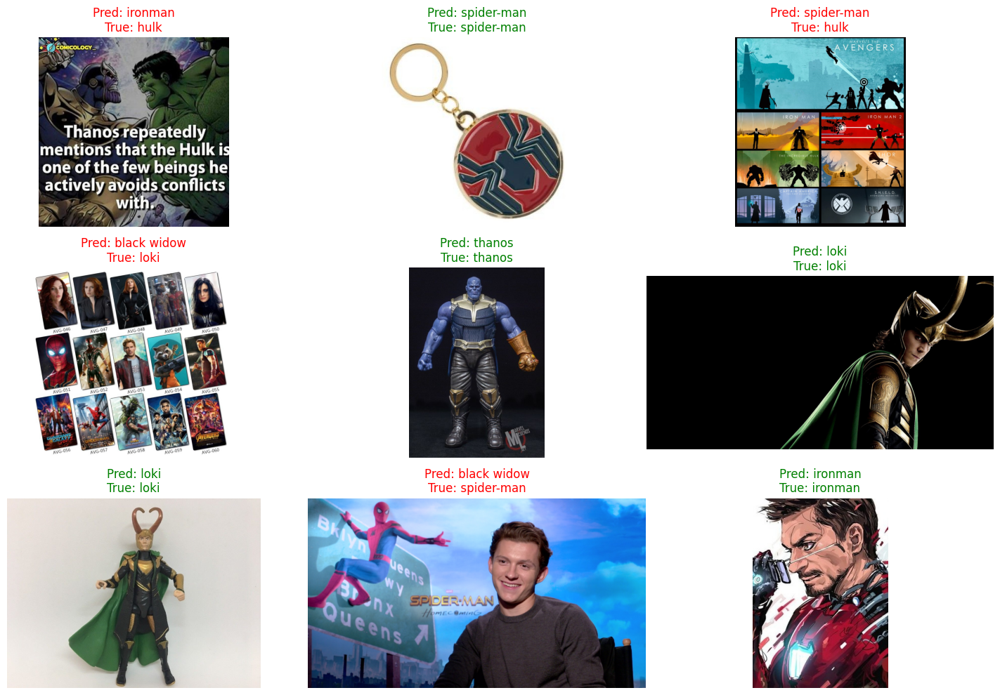

In [68]:
test_dataset.reset()

pred_probs = loaded_deeper_adam_model.predict(test_dataset, verbose=1)
pred_classes = np.argmax(pred_probs, axis=1)
true_classes = test_dataset.classes
class_labels = list(test_dataset.class_indices.keys())

file_paths = test_dataset.filepaths

num_to_display = 9
indices = np.random.choice(len(file_paths), size=num_to_display, replace=False)

plt.figure(figsize=(15, 10))
for i, idx in enumerate(indices):
    img_path = file_paths[idx]
    img = plt.imread(img_path)

    true_label = class_labels[true_classes[idx]]
    pred_label = class_labels[pred_classes[idx]]

    plt.subplot(3, 3, i+1)
    plt.imshow(img)
    plt.axis('off')
    color = 'green' if true_label == pred_label else 'red'
    plt.title(f"Pred: {pred_label}\nTrue: {true_label}", color=color)

plt.tight_layout()
plt.show()

> We can see that there is significant improvement in the number of predictions made by the deeper adam model.

####Optimizer Analysis - SGD VS Adam

15/15 ━━━━━━━━━━━━━━━━━━━━ 22s 1s/step


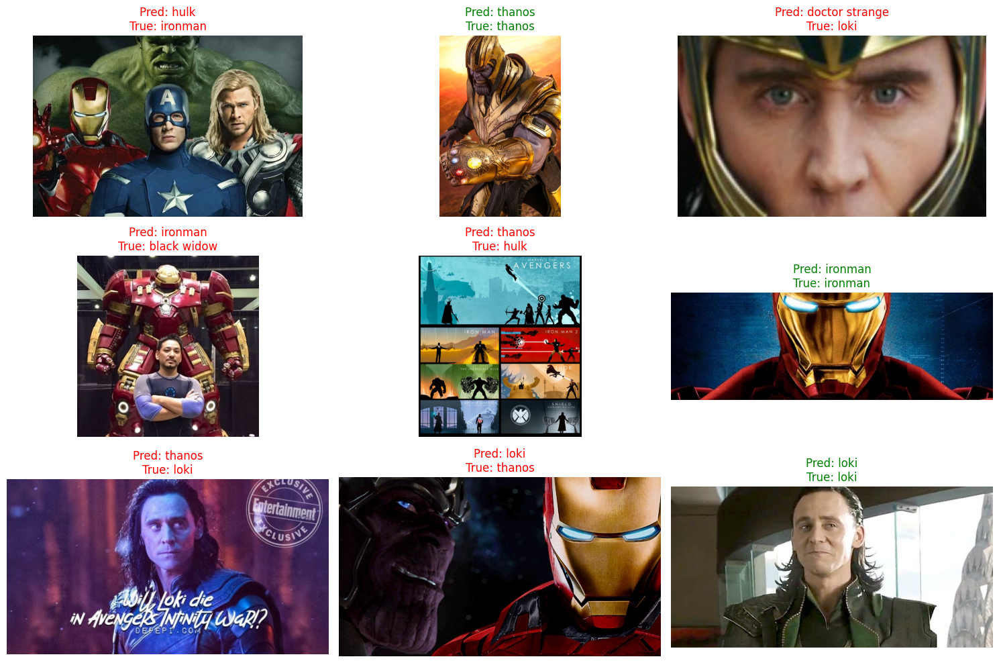

In [69]:
test_dataset.reset()

pred_probs = deeper_sgd_model_2.predict(test_dataset, verbose=1)
pred_classes = np.argmax(pred_probs, axis=1)
true_classes = test_dataset.classes
class_labels = list(test_dataset.class_indices.keys())

file_paths = test_dataset.filepaths

num_to_display = 9
indices = np.random.choice(len(file_paths), size=num_to_display, replace=False)

plt.figure(figsize=(15, 10))
for i, idx in enumerate(indices):
    img_path = file_paths[idx]
    img = plt.imread(img_path)

    true_label = class_labels[true_classes[idx]]
    pred_label = class_labels[pred_classes[idx]]

    plt.subplot(3, 3, i+1)
    plt.imshow(img)
    plt.axis('off')
    color = 'green' if true_label == pred_label else 'red'
    plt.title(f"Pred: {pred_label}\nTrue: {true_label}", color=color)

plt.tight_layout()
plt.show()

> Here we can see the deeper sgd model predicting the different superhero classe. The model's still confused between classes

15/15 ━━━━━━━━━━━━━━━━━━━━ 24s 2s/step


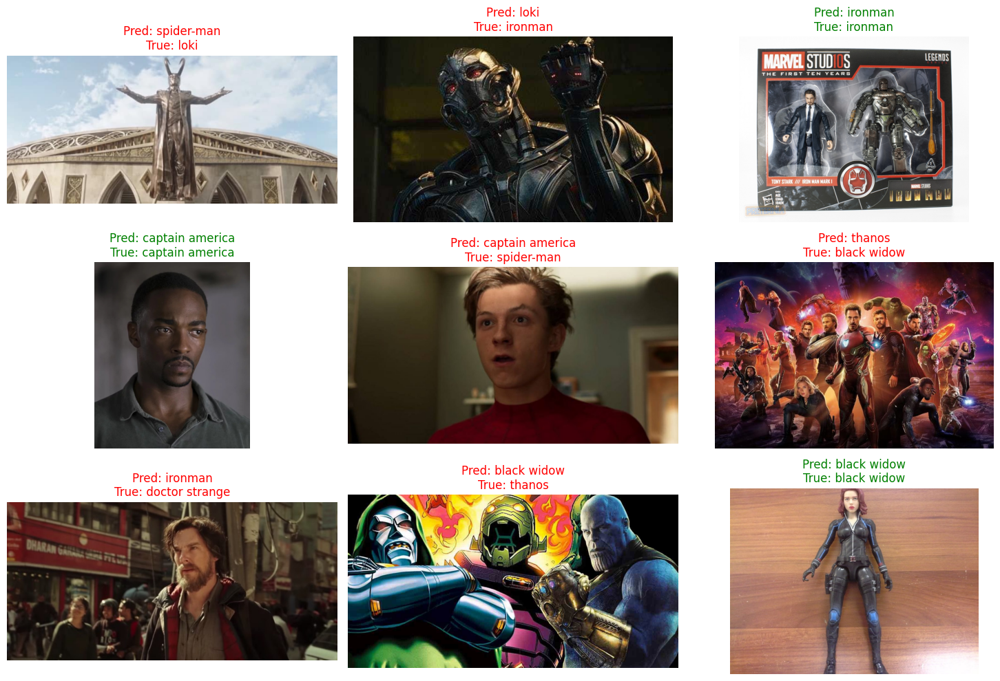

In [70]:
test_dataset.reset()

pred_probs = deeper_adam_model.predict(test_dataset, verbose=1)
pred_classes = np.argmax(pred_probs, axis=1)
true_classes = test_dataset.classes
class_labels = list(test_dataset.class_indices.keys())

file_paths = test_dataset.filepaths

num_to_display = 9
indices = np.random.choice(len(file_paths), size=num_to_display, replace=False)

plt.figure(figsize=(15, 10))
for i, idx in enumerate(indices):
    img_path = file_paths[idx]
    img = plt.imread(img_path)

    true_label = class_labels[true_classes[idx]]
    pred_label = class_labels[pred_classes[idx]]

    plt.subplot(3, 3, i+1)
    plt.imshow(img)
    plt.axis('off')
    color = 'green' if true_label == pred_label else 'red'
    plt.title(f"Pred: {pred_label}\nTrue: {true_label}", color=color)

plt.tight_layout()
plt.show()

> Here we can see that the predictions are a bit better than the deeper sgd model but not too significant.

Below we're importing the additional testing images that I downloaded manually from the web to check the accuracy of the model on cleaner images which contain proper only one precise superhero.

Found 22 images belonging to 8 classes.


/Users/grumpyyy/.pyenv/versions/3.10.11/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


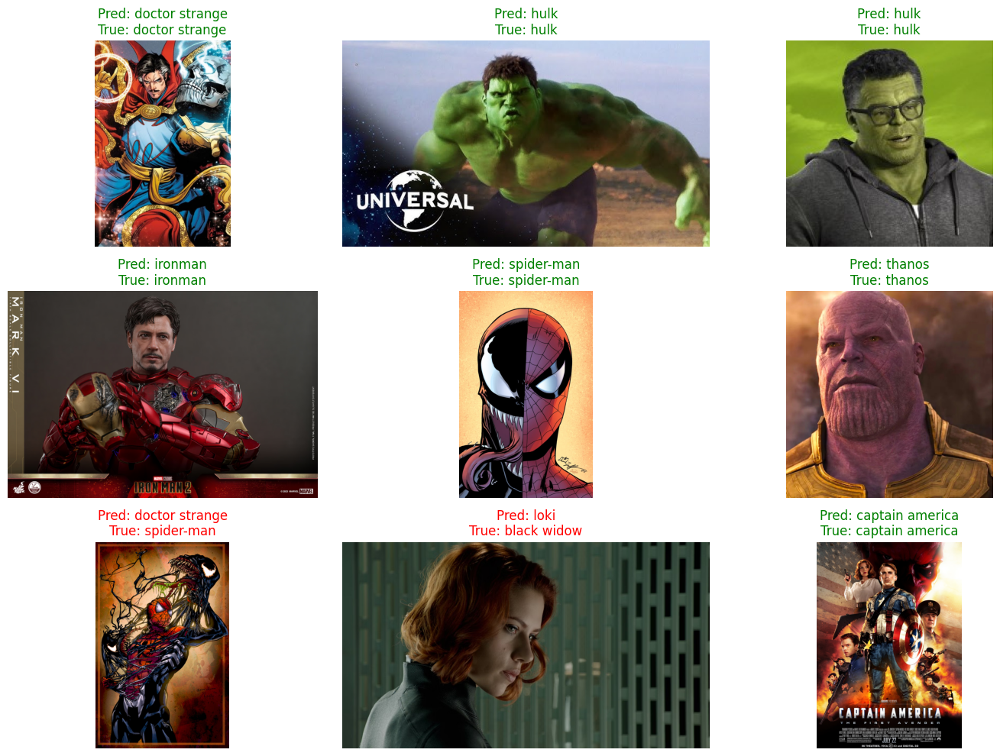

In [73]:
extra_test_datagen = ImageDataGenerator(rescale=1./255)
somesuperheros_dir = "AIML Assignment/somesuperheros"

extra_test_dataset = extra_test_datagen.flow_from_directory(
    somesuperheros_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='sparse',
    shuffle=False,
    seed=123
)

test_dataset.reset()

pred_probs = deeper_sgd_model_2.predict(extra_test_dataset, verbose=1)
pred_classes = np.argmax(pred_probs, axis=1)
true_classes = extra_test_dataset.classes
class_labels = list(extra_test_dataset.class_indices.keys())

file_paths = extra_test_dataset.filepaths

num_to_display = 9
indices = np.random.choice(len(file_paths), size=num_to_display, replace=False)

plt.figure(figsize=(15, 10))
for i, idx in enumerate(indices):

    img_path = file_paths[idx]
    img = plt.imread(img_path)

    true_label = class_labels[true_classes[idx]]
    pred_label = class_labels[pred_classes[idx]]

    plt.subplot(3, 3, i+1)
    plt.imshow(img)
    plt.axis('off')
    color = 'green' if true_label == pred_label else 'red'
    plt.title(f"Pred: {pred_label}\nTrue: {true_label}", color=color)

plt.tight_layout()
plt.show()


> Here we can see that the deeper SGD model is making more correct predictions for classes like hulk, ironman, thanos, spider-man, and captain america, indicating improvement with cleaner test data.
However, it is still misclassifying certain classes such as spider-man as doctor strange and black widow as loki, showing that some confusion between visually similar classes remains.

Found 22 images belonging to 8 classes.
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


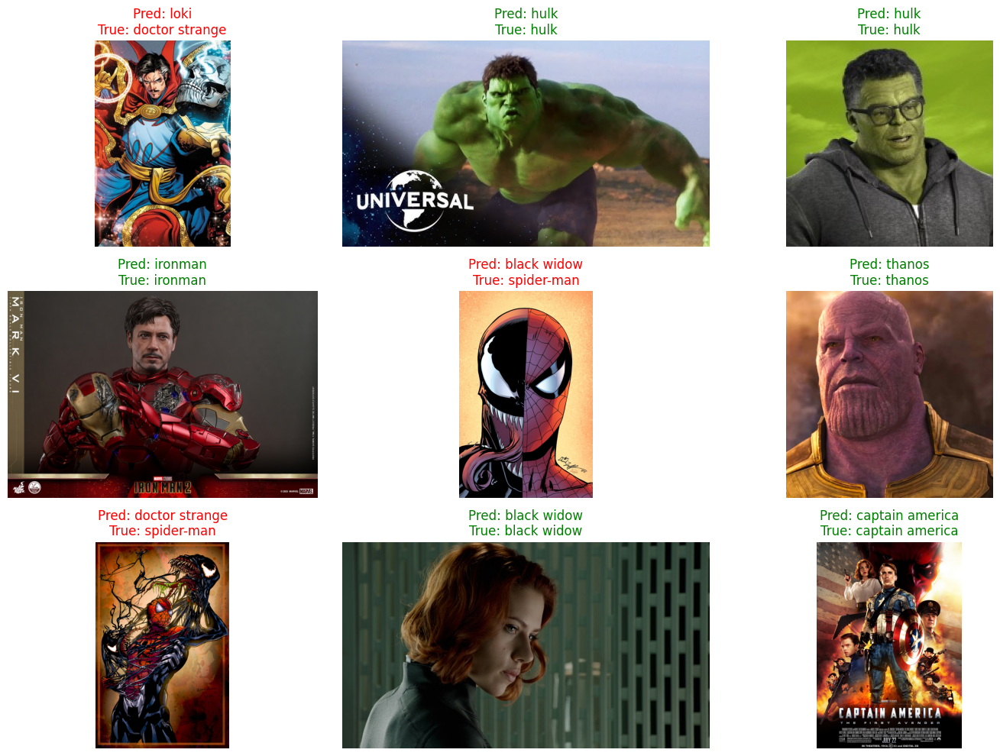

In [75]:
extra_test_datagen = ImageDataGenerator(rescale=1./255)
somesuperheros_dir = "AIML Assignment/somesuperheros"

extra_test_dataset = extra_test_datagen.flow_from_directory(
    somesuperheros_dir,  # This is the test directory
    target_size=(224, 224),
    batch_size=32,
    class_mode='sparse',
    shuffle=False,  # No shuffling for test data
    seed=123
)

test_dataset.reset()

pred_probs = deeper_adam_model.predict(extra_test_dataset, verbose=1)
pred_classes = np.argmax(pred_probs, axis=1)
true_classes = extra_test_dataset.classes
class_labels = list(extra_test_dataset.class_indices.keys())

file_paths = extra_test_dataset.filepaths

num_to_display = 9
indices = np.random.choice(len(file_paths), size=num_to_display, replace=False)

plt.figure(figsize=(15, 10))
for i, idx in enumerate(indices):

    img_path = file_paths[idx]
    img = plt.imread(img_path)

    true_label = class_labels[true_classes[idx]]
    pred_label = class_labels[pred_classes[idx]]

    plt.subplot(3, 3, i+1)
    plt.imshow(img)
    plt.axis('off')
    color = 'green' if true_label == pred_label else 'red'
    plt.title(f"Pred: {pred_label}\nTrue: {true_label}", color=color)

plt.tight_layout()
plt.show()


> Here we can see that the deeper adam model has correctly guessed 2 more classes in the extra testing data which show that the model is better performing than the deeper sgd model

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step


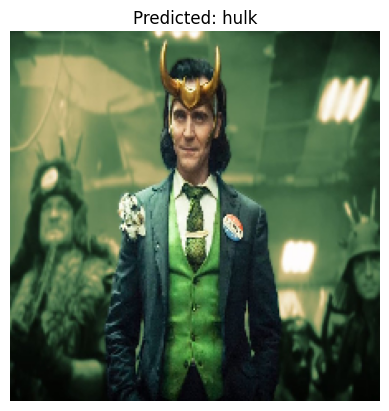

In [81]:
from tensorflow.keras.preprocessing import image
import numpy as np
import matplotlib.pyplot as plt

img_path = "AIML Assignment/somesuperheros/loki/whoisthis7.jpg"
img = image.load_img(img_path, target_size=(224, 224))

img_array = image.img_to_array(img)
img_array = img_array / 255.0
img_array = np.expand_dims(img_array, axis=0)

pred = deeper_sgd_model_2.predict(img_array)
pred_class = np.argmax(pred, axis=1)[0]
class_labels = list(test_dataset.class_indices.keys())
predicted_label = class_labels[pred_class]

plt.imshow(img)
plt.axis('off')
plt.title(f"Predicted: {predicted_label}")
plt.show()


> We are checking individual image for classification and the deeper sgd model incorrectly classifies the image of loki.

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


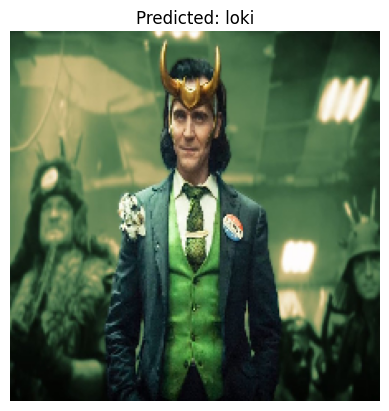

In [82]:
img_path = "AIML Assignment/somesuperheros/loki/whoisthis7.jpg"
img = image.load_img(img_path, target_size=(224, 224))

img_array = image.img_to_array(img)
img_array = img_array / 255.0
img_array = np.expand_dims(img_array, axis=0)

pred = deeper_adam_model.predict(img_array)
pred_class = np.argmax(pred, axis=1)[0]
class_labels = list(test_dataset.class_indices.keys())
predicted_label = class_labels[pred_class]

plt.imshow(img)
plt.axis('off')
plt.title(f"Predicted: {predicted_label}")
plt.show()

> Whereas the deeper adam is able to correctly classify the image of loki

####Challenges and Observations

> In the initial stage of the model training, when we used the data augmentation, due to the augmentation being too rigorous, the model was unable to capture any patterns while training. Thus, first we tried training the model without augmentation which resulted in model performing better and capturing some patterns, but it was overfitting. After this we got to know that excessive augmentation was the cause of model’s accuracy not increasing and inability of the model to capture patterns. So, we decreased the augmentation of the data to be slightly softer which resulted in better accuracy and better generalization of the model.

> Moreover, while training, we faced issues like overfitting in the Adam model which we tackled through deeper architecture and regularization techniques.
While building the deeper architecture, at one point the model was unable to learn anything from the dataset due to too complex architecture and too rigorous dropout and regularization. Thus, we had to tone down the drop out rate from 0.5 to 0.3 or 0.2 so that the model could learn the patterns without hitting performance bottleneck.

> Talking about the performance of the models, the among the baseline models, the sgd model is the better performing model (sgd optimizer) works better in the baseline model whereas in the deeper architecture model, the deeper adam optimizer model is the better performing model with significant imporvement in testing accuracy i.e. a 10% increase in testing accuracy

##Part II - Fine Tuning a Pre-Trained Model - Transfer Learning

###Loading and Adapting a Pretrained Model

In [83]:
input_shape = (224, 224, 3) ##resized input shape and color channel(RGB)
num_classes = 8 #toal number of classes in the dataset

In [84]:
base_model = MobileNetV2(
    input_shape=input_shape,
    include_top=False,
    weights='imagenet'
)
base_model.trainable = False

9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


> Here we are loading the base model i.e. the MobileNetV2 where we have frozen the top layers of the model (not training the model initially) i.e. feature extraction part.

In [85]:
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dropout(0.5)(x)
x = Dense(128, activation='relu')(x)
x = Dropout(0.3)(x)
predictions = Dense(num_classes, activation='softmax')(x)

Here we are making custom classification head on top of the pretrained model. First we are taking the feauture map of the MobileNetV2 which contains the features extracted from the imagenet input images. The we used the global average pooling to flattern the feature map into a 1D vectore of features. Then we have a dropout layer of 0.5 which means it sets 50% input units to 0 which helps in the prevention of overfitting. Then there a fully connected layer with 128 units and ReLU activation function which helps in capturing non-linear patterns in the features. Then another dropout layer is used with 0.3 values which helps in additional regularization. Then finally there is

In [86]:
transfer_model = Model(inputs=base_model.input, outputs=predictions)
transfer_model.summary()

Model: "functional_87"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_5       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1 (Conv2D)      │ (None, 112, 112,  │        864 │ input_layer_5[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bn_Conv1            │ (None, 112, 112,  │        128 │ Conv1[0][0]       │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1_relu (ReLU)   │ (None, 112, 112,  │          0 │ bn_Conv1[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        288 │ Conv1_relu[0][0]  │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        128 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │          0 │ expanded_conv_de… │
│ (ReLU)              │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │        512 │ expanded_conv_de… │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand      │ (None, 112, 112,  │      1,536 │ expanded_conv_pr… │
│ (Conv2D)            │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_BN   │ (None, 112, 112,  │        384 │ block_1_expand[0… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_relu │ (None, 112, 112,  │          0 │ block_1_expand_B… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_pad         │ (None, 113, 113,  │          0 │ block_1_expand_r… │
│ (ZeroPadding2D)     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise   │ (None, 56, 56,    │        864 │ block_1_pad[0][0] │
│ (DepthwiseConv2D)   │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │        384 │ block_1_depthwis… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │          0 │ block_1_depthwis… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_project     │ (None, 56, 56,    │      2,304 │ block_1_depthwis

 Total params: 2,422,984 (9.24 MB)

 Trainable params: 165,000 (644.53 KB)

 Non-trainable params: 2,257,984 (8.61 MB)

###Model Training and Fine Tuning

#####Model Training

In [87]:
transfer_model.compile(
    optimizer=Adam(learning_rate=1e-3),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)


In [88]:
callbacks = [
    ModelCheckpoint("transfer_dar_model.keras", save_best_only=True, monitor="val_accuracy", mode="max"),
    EarlyStopping(monitor="val_loss", patience=5, restore_best_weights=True),
    ReduceLROnPlateau(monitor="val_loss", factor=0.5, patience=3, min_lr=1e-5)
]

history_transfer = transfer_model.fit(
    training_dataset,
    validation_data=validation_dataset,
    epochs=15,
    callbacks=callbacks
)

Epoch 1/15
65/65 ━━━━━━━━━━━━━━━━━━━━ 85s 1s/step - accuracy: 0.1970 - loss: 2.3816 - val_accuracy: 0.4922 - val_loss: 1.6468 - learning_rate: 0.0010
Epoch 2/15
65/65 ━━━━━━━━━━━━━━━━━━━━ 79s 1s/step - accuracy: 0.3022 - loss: 1.8626 - val_accuracy: 0.6187 - val_loss: 1.2974 - learning_rate: 0.0010
Epoch 3/15
65/65 ━━━━━━━━━━━━━━━━━━━━ 82s 1s/step - accuracy: 0.3810 - loss: 1.7142 - val_accuracy: 0.6381 - val_loss: 1.1483 - learning_rate: 0.0010
Epoch 4/15
65/65 ━━━━━━━━━━━━━━━━━━━━ 85s 1s/step - accuracy: 0.4329 - loss: 1.5596 - val_accuracy: 0.7354 - val_loss: 1.0040 - learning_rate: 0.0010
Epoch 5/15
65/65 ━━━━━━━━━━━━━━━━━━━━ 65s 1s/step - accuracy: 0.4650 - loss: 1.5238 - val_accuracy: 0.7588 - val_loss: 0.9943 - learning_rate: 0.0010
Epoch 6/15
65/65 ━━━━━━━━━━━━━━━━━━━━ 63s 965ms/step - accuracy: 0.5075 - loss: 1.4208 - val_accuracy: 0.7588 - val_loss: 0.9394 - learning_rate: 0.0010
Epoch 7/15
65/65 ━━━━━━━━━━━━━━━━━━━━ 62s 958ms/step - accuracy: 0.5068 - loss: 1.4019 - val_accu

> In the transfer model, while initially training, we have frozen the layers to prevent the weights from being updated during feature extraction.

> We have set the training to run for 15 epochs. From the logs, we can observe that the validation accuracy starts at 0.4922 with a validation loss of 1.6468.

> As training progresses, there is a steady increase in validation accuracy and a corresponding decrease in validation loss. By epoch 15, the validation accuracy reaches 0.7510, and the validation loss reduces to 0.8442, indicating consistent improvement in the model’s generalization performance.

> This shows the model is learning effectively even during the early frozen-layer training phase.

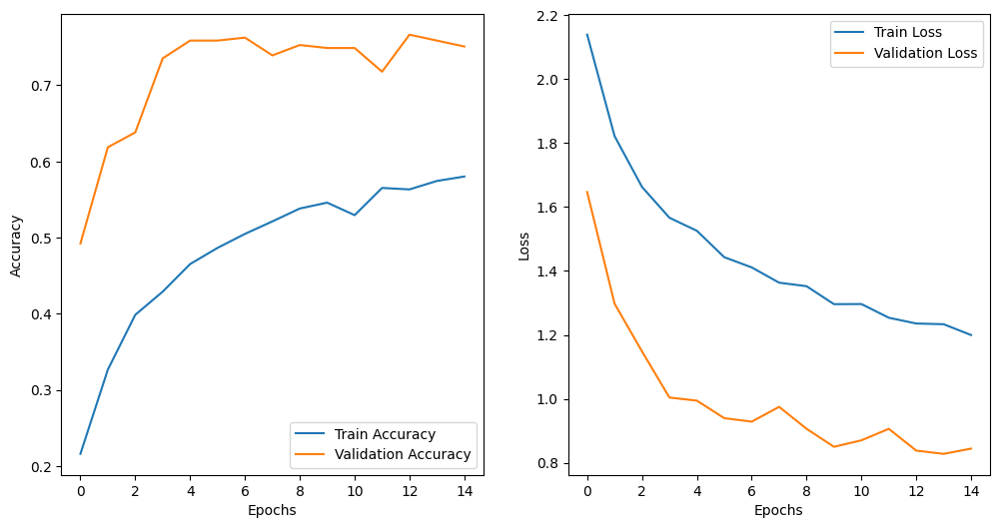

In [89]:
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(history_transfer.history['accuracy'], label='Train Accuracy')
plt.plot(history_transfer.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history_transfer.history['loss'], label='Train Loss')
plt.plot(history_transfer.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.show()

> Here we can see the accuracy and the loss curve of the model. Both the training and validation accuracy increase significantly and start to plateau around the 13th to 14th epoch, indicating that the model is approaching convergence.
> Similarly, after the 13th epoch, the validation loss also stops decreasing, which further confirms the stabilization and convergence of the model during this phase of training.

####Fine Tuning

In [90]:
base_model.trainable = True
for layer in base_model.layers[:-20]:
    layer.trainable = False

transfer_model.compile(
    optimizer=Adam(learning_rate=1e-5),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

> Now here we unfroze the top 20 layers of the model to learn the features of our dataset which maybe distinct to the features that it prelearned in the imagenet dataset.

In [91]:
history_finetune = transfer_model.fit(
    training_dataset,
    validation_data=validation_dataset,
    epochs=15,
    callbacks=callbacks
)

Epoch 1/15
65/65 ━━━━━━━━━━━━━━━━━━━━ 82s 1s/step - accuracy: 0.4729 - loss: 1.4101 - val_accuracy: 0.7860 - val_loss: 0.7944 - learning_rate: 1.0000e-05
Epoch 2/15
65/65 ━━━━━━━━━━━━━━━━━━━━ 77s 1s/step - accuracy: 0.5165 - loss: 1.3471 - val_accuracy: 0.7821 - val_loss: 0.7947 - learning_rate: 1.0000e-05
Epoch 3/15
65/65 ━━━━━━━━━━━━━━━━━━━━ 77s 1s/step - accuracy: 0.5355 - loss: 1.3008 - val_accuracy: 0.7977 - val_loss: 0.7696 - learning_rate: 1.0000e-05
Epoch 4/15
65/65 ━━━━━━━━━━━━━━━━━━━━ 91s 1s/step - accuracy: 0.5647 - loss: 1.2772 - val_accuracy: 0.7840 - val_loss: 0.7786 - learning_rate: 1.0000e-05
Epoch 5/15
65/65 ━━━━━━━━━━━━━━━━━━━━ 81s 1s/step - accuracy: 0.5630 - loss: 1.2534 - val_accuracy: 0.7782 - val_loss: 0.7740 - learning_rate: 1.0000e-05
Epoch 6/15
65/65 ━━━━━━━━━━━━━━━━━━━━ 81s 1s/step - accuracy: 0.5560 - loss: 1.2357 - val_accuracy: 0.7529 - val_loss: 0.7702 - learning_rate: 1.0000e-05
Epoch 7/15
65/65 ━━━━━━━━━━━━━━━━━━━━ 80s 1s/step - accuracy: 0.5714 - loss:

> In this fine-tuning phase, we continued training after unfreezing the layers, using a reduced learning rate to refine the model further.
We have set the training to run for 15 epochs. From the logs, we can observe that the validation accuracy starts at 0.7860 with a validation loss of 0.7944

> As training progresses, the validation accuracy remains consistently high, and the validation loss steadily decreases. By epoch 12, the model reaches its lowest validation loss of 0.7086 and a validation accuracy of 0.7879, showing the model’s peak generalization in this phase.
Similarly, after the 13th epoch, the validation loss stops decreasing, which further confirms the stabilization and convergence of the model during this stage of training.

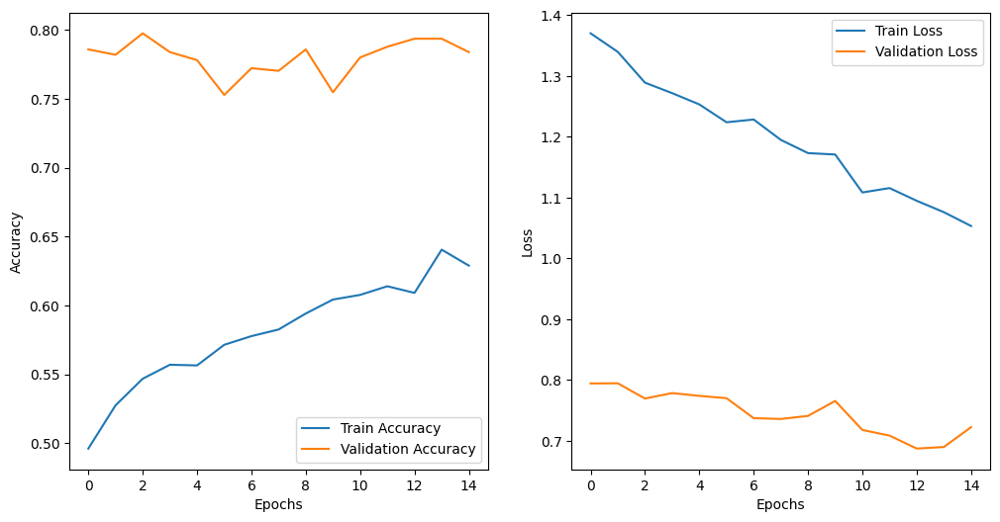

In [92]:
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(history_finetune.history['accuracy'], label='Train Accuracy')
plt.plot(history_finetune.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history_finetune.history['loss'], label='Train Loss')
plt.plot(history_finetune.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.show()

> Here we can see that the validation accuracy starts at a relatively high level and continues to increase gradually over the epochs, showing stable learning with fine-tuning.

>Similarly, the validation loss begins low and steadily decreases until around epoch 12, after which it stabilizes and slightly fluctuates, indicating that the model has likely reached convergence. This trend reflects effective performance during the fine-tuning stage.

###Model Evaluation and Prediction

In [93]:
test_loss, test_accuracy = transfer_model.evaluate(test_dataset)
print(f"Test Accuracy: {test_accuracy*100:.2f}%")
print(f"Test Loss: {test_loss:.4f}")

15/15 ━━━━━━━━━━━━━━━━━━━━ 9s 588ms/step - accuracy: 0.5659 - loss: 1.3968
Test Accuracy: 60.53%
Test Loss: 1.2420


> Here we can see the accuracy of the model in the testing dataset which came out almost 60% which is a big leap compared to the previous models

In [94]:
y_true = test_dataset.classes
y_pred_probs = transfer_model.predict(test_dataset)
y_pred = np.argmax(y_pred_probs, axis=1)

class_names = list(test_dataset.class_indices.keys())

print(classification_report(y_true, y_pred, target_names=class_names))

15/15 ━━━━━━━━━━━━━━━━━━━━ 9s 603ms/step
                 precision    recall  f1-score   support

    black widow       0.49      0.45      0.47        55
captain america       0.54      0.51      0.52        57
 doctor strange       0.61      0.62      0.62        61
           hulk       0.71      0.64      0.67        56
        ironman       0.57      0.70      0.62        56
           loki       0.74      0.37      0.49        54
     spider-man       0.73      0.82      0.78        57
         thanos       0.53      0.71      0.61        55

       accuracy                           0.61       451
      macro avg       0.62      0.60      0.60       451
   weighted avg       0.62      0.61      0.60       451



> Here we can also see that the classification performance across all classes has improved significantly after transfer learning.

>The most correctly predicted class is still spider-man, with a precision of 0.73, recall of 0.82, and f1-score of 0.78, indicating strong model confidence and accuracy.


> Overall, the model achieves a macro average f1-score of 0.60 and a weighted average accuracy of 0.61, reflecting balanced performance across all classes.

15/15 ━━━━━━━━━━━━━━━━━━━━ 12s 773ms/step


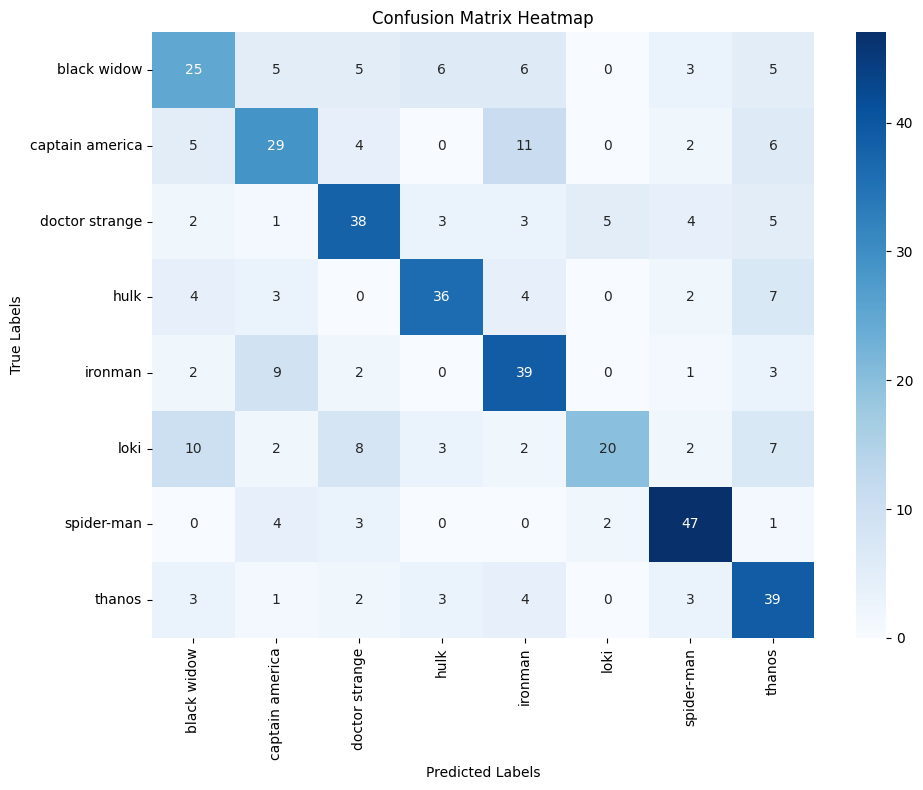

In [95]:
y_true = test_dataset.classes
y_pred_probs = transfer_model.predict(test_dataset)
y_pred = np.argmax(y_pred_probs, axis=1)

cm = confusion_matrix(y_true, y_pred)

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=True,
            xticklabels=test_dataset.class_indices.keys(),
            yticklabels=test_dataset.class_indices.keys())
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix Heatmap')
plt.tight_layout()
plt.show()

> Here we can see the confusion matrix of the tranfer learning model after fine tuning where we can see that the performance of the model is noticable better than the previous models. We can see better generalization of the model.

15/15 ━━━━━━━━━━━━━━━━━━━━ 7s 446ms/step


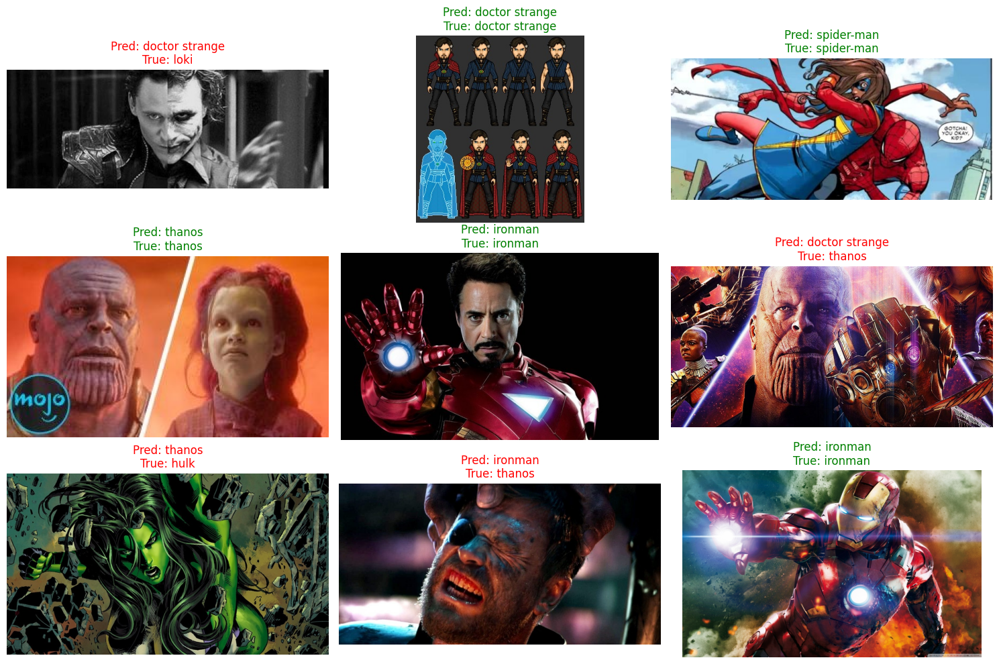

In [96]:
test_dataset.reset()

pred_probs = transfer_model.predict(test_dataset, verbose=1)
pred_classes = np.argmax(pred_probs, axis=1)
true_classes = test_dataset.classes
class_labels = list(test_dataset.class_indices.keys())

file_paths = test_dataset.filepaths

num_to_display = 9
indices = np.random.choice(len(file_paths), size=num_to_display, replace=False)

plt.figure(figsize=(15, 10))
for i, idx in enumerate(indices):
    img_path = file_paths[idx]
    img = plt.imread(img_path)

    true_label = class_labels[true_classes[idx]]
    pred_label = class_labels[pred_classes[idx]]

    plt.subplot(3, 3, i+1)
    plt.imshow(img)
    plt.axis('off')
    color = 'green' if true_label == pred_label else 'red'
    plt.title(f"Pred: {pred_label}\nTrue: {true_label}", color=color)

plt.tight_layout()
plt.show()

> After using tranfer learning and fine tuning the model we can see that the model is predicting the superhero classes extremely well compared to the previous models.

In [99]:
extra_test_datagen = ImageDataGenerator(rescale=1./255)
somesuperheros_dir = "AIML Assignment/somesuperheros"

extra_test_dataset = extra_test_datagen.flow_from_directory(
    somesuperheros_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='sparse',
    shuffle=False,
    seed=123
)

Found 22 images belonging to 8 classes.


In [100]:
test_loss, test_accuracy = transfer_model.evaluate(extra_test_dataset)
print(f"Test Accuracy: {test_accuracy*100:.2f}%")
print(f"Test Loss: {test_loss:.4f}")

/Users/grumpyyy/.pyenv/versions/3.10.11/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 428ms/step - accuracy: 0.8636 - loss: 0.7172
Test Accuracy: 86.36%
Test Loss: 0.7172


> Here we can also see the model's performance in extra test data which was later collected thorugh the web for checking how the model performs in more precise image with less confusion in the images.

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step


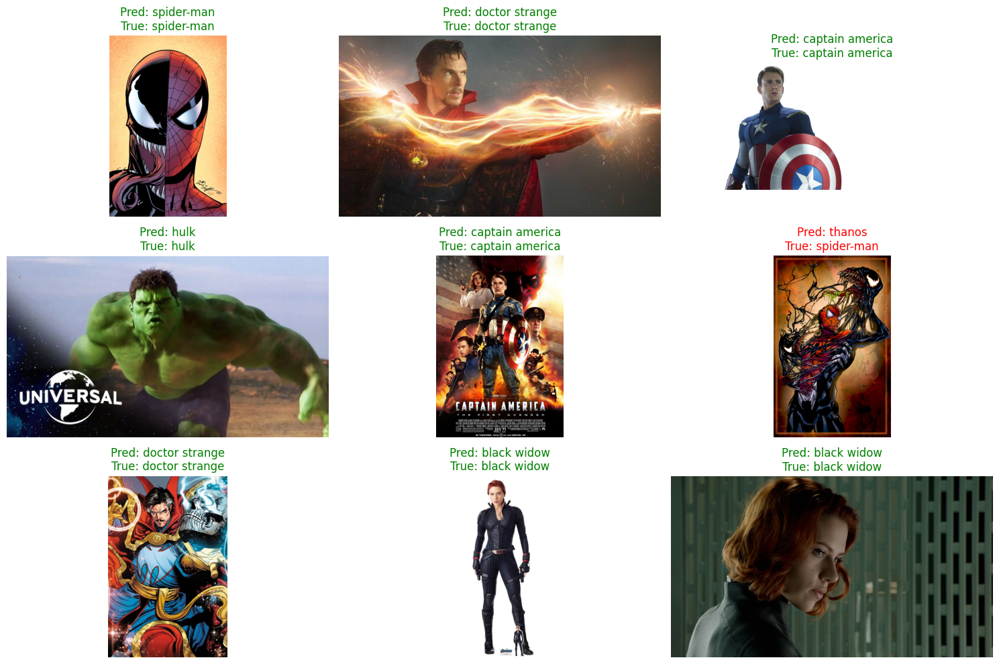

In [101]:
test_dataset.reset()

pred_probs = transfer_model.predict(extra_test_dataset, verbose=1)
pred_classes = np.argmax(pred_probs, axis=1)
true_classes = extra_test_dataset.classes
class_labels = list(extra_test_dataset.class_indices.keys())

file_paths = extra_test_dataset.filepaths

num_to_display = 9
indices = np.random.choice(len(file_paths), size=num_to_display, replace=False)

plt.figure(figsize=(15, 10))
for i, idx in enumerate(indices):

    img_path = file_paths[idx]
    img = plt.imread(img_path)

    true_label = class_labels[true_classes[idx]]
    pred_label = class_labels[pred_classes[idx]]

    plt.subplot(3, 3, i+1)
    plt.imshow(img)
    plt.axis('off')
    color = 'green' if true_label == pred_label else 'red'
    plt.title(f"Pred: {pred_label}\nTrue: {true_label}", color=color)

plt.tight_layout()
plt.show()


> Here we can see that the most of the previously incorrectly classified images are all being correctly classified in the transfer learning model

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


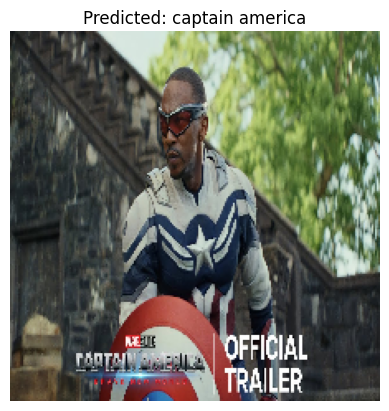

In [102]:
img_path = "AIML Assignment/somesuperheros/captain america/whoisthis14.jpg"
img = image.load_img(img_path, target_size=(224, 224))

img_array = image.img_to_array(img)
img_array = img_array / 255.0
img_array = np.expand_dims(img_array, axis=0)

pred = transfer_model.predict(img_array)
pred_class = np.argmax(pred, axis=1)[0]
class_labels = list(test_dataset.class_indices.keys())
predicted_label = class_labels[pred_class]

plt.imshow(img)
plt.axis('off')
plt.title(f"Predicted: {predicted_label}")
plt.show()

> Here I've used the image of the newest captain america movie in the marvel cinematic universe which indeed proves that the model is predicting well and capturing patterns well as the training data was last updated 4 years ago and this movie was out just this year.

> This shows that the model is generalized and is able to make predictions quite good.